## Imports and Functions

In [2]:

import numpy as np
import pandas as pd
import statistics
import matplotlib.pyplot as plt
import seaborn as sns
import shap
import scikitplot as skplt
import pymc3 as pm

from matplotlib.colors import ListedColormap
cmap = ListedColormap(sns.color_palette("husl",3))

from sklearn.preprocessing import normalize, StandardScaler, MinMaxScaler 
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor,export_graphviz
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, AdaBoostClassifier, AdaBoostRegressor, bagging, BaggingClassifier, BaggingRegressor 
from sklearn.svm import LinearSVC, SVC
from sklearn.model_selection import cross_val_score,GridSearchCV
from IPython.core.display import Image, display
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score,roc_curve, auc, precision_recall_curve, average_precision_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.externals.six import StringIO
from subprocess import call
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

sns.set(font_scale=1.5)
plt.style.use('fivethirtyeight')


%matplotlib inline
%config InlineBackend.figure_format = 'retina'

pd.set_option('display.max_columns', 150)



In [2]:
def fill_error(data,error1):
    """
    Replaces the nans in the errors columns with a 0 - this will be used where it is more accurate to replace the
    nan with a 0
    """
    data[error1].replace(np.nan, 0,inplace=True)
    
    


In [3]:
# Necessary to run and display SHAP graphs
shap.initjs()

# Kepler Telescope, identifying lights of interest

In [ ]:
"""
https://exoplanetarchive.ipac.caltech.edu/docs/API_kepcandidate_columns.html


https://github.com/JstnClmnt/SpaceApps/blob/master/README.md

All that are marked as confimred are in the data set above
"""

In [5]:
url = "https://exoplanetarchive.ipac.caltech.edu/cgi-bin/nstedAPI/nph-nstedAPI?table=cumulative&select=*=dec" 

In [6]:
#  Download the csv formatted data from the NASA API. Reading it using the built in pandas function
url_saved = pd.read_csv(url)

In [7]:
# Checking the first 5 lines of the data and how many columns it pulled down
url_saved.head()

,kepid,kepoi_name,kepler_name,ra,ra_err,ra_str,dec,dec_err,dec_str,koi_gmag,koi_gmag_err,koi_rmag,koi_rmag_err,koi_imag,koi_imag_err,koi_zmag,koi_zmag_err,koi_jmag,koi_jmag_err,koi_hmag,koi_hmag_err,koi_kmag,koi_kmag_err,koi_kepmag,koi_kepmag_err,koi_delivname,koi_vet_stat,koi_quarters,koi_disposition,koi_pdisposition,koi_count,koi_num_transits,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_limbdark_mod,koi_ldm_coeff4,koi_ldm_coeff3,koi_ldm_coeff2,koi_ldm_coeff1,koi_trans_mod,koi_model_snr,koi_model_dof,koi_model_chisq,koi_time0bk,koi_time0bk_err1,koi_time0bk_err2,koi_eccen,koi_eccen_err1,koi_eccen_err2,koi_longp,koi_longp_err1,koi_longp_err2,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_sma_err1,koi_sma_err2,koi_impact,koi_impact_err1,koi_impact_err2,koi_duration,koi_duration_err1,koi_duration_err2,koi_ingress,koi_ingress_err1,koi_ingress_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period,koi_period_err1,koi_period_err2,koi_ror,...,koi_dor_err1,koi_dor_err2,koi_incl,koi_incl_err1,koi_incl_err2,koi_teq,koi_teq_err1,koi_teq_err2,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_sage,koi_sage_err1,koi_sage_err2,koi_sparprov,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_dicco_mra,koi_dicco_mra_err,koi_dicco_mdec,koi_dicco_mdec_err,koi_dicco_msky,koi_dicco_msky_err,koi_dikco_mra,koi_dikco_mra_err,koi_dikco_mdec,koi_dikco_mdec_err,koi_dikco_msky,koi_dikco_msky_err,koi_comment,koi_vet_date,koi_tce_plnt_num,koi_tce_delivname,koi_datalink_dvs,koi_disp_prov,koi_parm_prov,koi_time0,koi_time0_err1,koi_time0_err2,koi_datalink_dvr,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2,koi_fittype,koi_score
0,10797460,K00752.01,Kepler-227 b,291.93423,0.0,19h27m44.22s,48.141651,0.0,+48d08m29.9s,15.890,NaN,15.270,NaN,15.114,NaN,15.006,NaN,14.082,0.025,13.751,0.030,13.648,0.054,15.347,NaN,cumulative,Done,11111111111111111000000000000000,CONFIRMED,CANDIDATE,2,142.0,5.135849,28.470820,0.6864,Claret (2011 A&A 529 75) ATLAS LS,0.0,0.0,0.2291,0.4603,Mandel and Agol (2002 ApJ 580 171),35.8,NaN,NaN,170.538750,0.002160,-0.002160,0.0,NaN,NaN,NaN,NaN,NaN,2.26,0.26,-0.15,0.0853,NaN,NaN,0.146,0.318,-0.146,2.95750,0.08190,-0.08190,NaN,NaN,NaN,615.8,19.5,-19.5,9.488036,2.775000e-05,-2.775000e-05,0.022344,...,2.600,-2.600,89.66,NaN,NaN,793.0,NaN,NaN,5455.0,81.0,-81.0,4.467,0.064,-0.096,0.14,0.15,-0.15,0.927,0.105,-0.061,0.919,0.052,-0.046,NaN,NaN,NaN,q1_q17_dr25_stellar,0.002,19.462294,1.400000e-05,48.14191,0.000130,0.430,0.510,0.940,0.480,-0.00020,0.00032,-0.00055,0.00031,-0.010,0.130,0.200,0.160,0.200,0.170,0.080,0.130,0.310,0.170,0.320,0.160,NO_COMMENT,2018-08-16,1.0,q1_q17_dr25_tce,010/010797/010797460/dv/kplr010797460-001-2016...,q1_q17_dr25_sup_koi,q1_q17_dr25_koi,2455003.539,0.002160,-0.002160,010/010797/010797460/dv/kplr010797460-20160209...,0,0,0,0,93.59,29.45,-16.65,3.20796,0.33173,-1.09986,LS+MCMC,1.000
1,10797460,K00752.02,Kepler-227 c,291.93423,0.0,19h27m44.22s,48.141651,0.0,+48d08m29.9s,15.890,NaN,15.270,NaN,15.114,NaN,15.006,NaN,14.082,0.025,13.751,0.030,13.648,0.054,15.347,NaN,cumulative,Done,11111111111111111000000000000000,CONFIRMED,CANDIDATE,2,25.0,7.027669,20.109507,0.0023,Claret (2011 A&A 529 75) ATLAS LS,0.0,0.0,0.2291,0.4603,Mandel and Agol (2002 ApJ 580 171),25.8,NaN,NaN,162.513840,0.003520,-0.003520,0.0,NaN,NaN,NaN,NaN,NaN,2.83,0.32,-0.19,0.2734,NaN,NaN,0.586,0.059,-0.443,4.50700,0.11600,-0.11600,NaN,NaN,NaN,874.8,35.5,-35.5,54.418383,2.479000e-04,-2.479000e-04,0.027954,...,28.400,-28.400,89.57,NaN,NaN,443.0,NaN,NaN,5455.0,81.0,-81.0,4.467,0.064,-0.096,0.14,0.15,-0.15,0.927,0.105,-0.061,0.919,0.052,-0.046,NaN,NaN,NaN,q1_q17_dr25_stellar,0.003,

In [8]:
# Scanning over the column names so I have an idea of the data 
for a in url_saved.columns:
    print(a)

kepid
kepoi_name
kepler_name
ra
ra_err
ra_str
dec
dec_err
dec_str
koi_gmag
koi_gmag_err
koi_rmag
koi_rmag_err
koi_imag
koi_imag_err
koi_zmag
koi_zmag_err
koi_jmag
koi_jmag_err
koi_hmag
koi_hmag_err
koi_kmag
koi_kmag_err
koi_kepmag
koi_kepmag_err
koi_delivname
koi_vet_stat
koi_quarters
koi_disposition
koi_pdisposition
koi_count
koi_num_transits
koi_max_sngle_ev
koi_max_mult_ev
koi_bin_oedp_sig
koi_limbdark_mod
koi_ldm_coeff4
koi_ldm_coeff3
koi_ldm_coeff2
koi_ldm_coeff1
koi_trans_mod
koi_model_snr
koi_model_dof
koi_model_chisq
koi_time0bk
koi_time0bk_err1
koi_time0bk_err2
koi_eccen
koi_eccen_err1
koi_eccen_err2
koi_longp
koi_longp_err1
koi_longp_err2
koi_prad
koi_prad_err1
koi_prad_err2
koi_sma
koi_sma_err1
koi_sma_err2
koi_impact
koi_impact_err1
koi_impact_err2
koi_duration
koi_duration_err1
koi_duration_err2
koi_ingress
koi_ingress_err1
koi_ingress_err2
koi_depth
koi_depth_err1
koi_depth_err2
koi_period
koi_period_err1
koi_period_err2
koi_ror
koi_ror_err1
koi_ror_err2
koi_dor
koi_dor_e

In [9]:
# Checking this variable as it will be my target, looking at what values are present
url_saved.loc[:,'koi_disposition']

0            CONFIRMED
1            CONFIRMED
2            CANDIDATE
3       FALSE POSITIVE
4            CONFIRMED
5            CONFIRMED
6            CONFIRMED
7            CONFIRMED
8       FALSE POSITIVE
9            CONFIRMED
10           CONFIRMED
11           CONFIRMED
12           CONFIRMED
13           CONFIRMED
14      FALSE POSITIVE
15      FALSE POSITIVE
16      FALSE POSITIVE
17      FALSE POSITIVE
18           CONFIRMED
19           CONFIRMED
20      FALSE POSITIVE
21           CONFIRMED
22           CONFIRMED
23           CONFIRMED
24      FALSE POSITIVE
25           CONFIRMED
26           CONFIRMED
27           CONFIRMED
28      FALSE POSITIVE
29      FALSE POSITIVE
             ...      
9534    FALSE POSITIVE
9535    FALSE POSITIVE
9536         CANDIDATE
9537    FALSE POSITIVE
9538         CANDIDATE
9539    FALSE POSITIVE
9540    FALSE POSITIVE
9541    FALSE POSITIVE
9542         CANDIDATE
9543    FALSE POSITIVE
9544    FALSE POSITIVE
9545    FALSE POSITIVE
9546    FAL

In [10]:
# Saving the dataframe onto my computer 
pd.DataFrame.to_csv(url_saved, '../nasa_kepler_interest/nasa_cumulative.csv')

In [11]:
# Reading it from my hard drive into pandas
koi = pd.read_csv('../nasa_kepler_interest/nasa_cumulative.csv', index_col=0 )

In [11]:
# Browsing the data collected and looking into the mean and standard deviations for each column and observing 
# the difference between the third quartile and max number
koi.describe()

,kepid,ra,ra_err,dec,dec_err,koi_gmag,koi_gmag_err,koi_rmag,koi_rmag_err,koi_imag,koi_imag_err,koi_zmag,koi_zmag_err,koi_jmag,koi_jmag_err,koi_hmag,koi_hmag_err,koi_kmag,koi_kmag_err,koi_kepmag,koi_kepmag_err,koi_count,koi_num_transits,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_ldm_coeff4,koi_ldm_coeff3,koi_ldm_coeff2,koi_ldm_coeff1,koi_model_snr,koi_model_dof,koi_model_chisq,koi_time0bk,koi_time0bk_err1,koi_time0bk_err2,koi_eccen,koi_eccen_err1,koi_eccen_err2,koi_longp,koi_longp_err1,koi_longp_err2,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_sma_err1,koi_sma_err2,koi_impact,koi_impact_err1,koi_impact_err2,koi_duration,koi_duration_err1,koi_duration_err2,koi_ingress,koi_ingress_err1,koi_ingress_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_incl_err1,koi_incl_err2,koi_teq,koi_teq_err1,koi_teq_err2,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_sage,koi_sage_err1,koi_sage_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_dicco_mra,koi_dicco_mra_err,koi_dicco_mdec,koi_dicco_mdec_err,koi_dicco_msky,koi_dicco_msky_err,koi_dikco_mra,koi_dikco_mra_err,koi_dikco_mdec,koi_dikco_mdec_err,koi_dikco_msky,koi_dikco_msky_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2,koi_score
count,9.564000e+03,9564.000000,9564.0,9564.000000,9564.0,9523.000000,0.0,9555.000000,0.0,9410.000000,0.0,8951.000000,0.0,9539.000000,9492.000000,9539.000000,9467.000000,9539.00000,9371.000000,9563.000000,0.0,9564.000000,8422.000000,8422.000000,8422.000000,8054.000000,9201.0,9201.0,9201.000000,9201.000000,9201.000000,0.0,0.0,9564.000000,9110.000000,9110.000000,9201.0,0.0,0.0,0.0,0.0,0.0,9201.000000,9201.000000,9201.000000,9201.000000,0.0,0.0,9201.000000,9110.000000,9110.000000,9564.000000,9110.000000,9110.000000,0.0,0.0,0.0,9.201000e+03,9110.000000,9110.000000,9564.000000,9110.000000,9110.000000,9201.000000,9201.000000,9201.000000,9201.000000,9110.000000,9110.000000,9200.000000,0.0,0.0,9201.000000,0.0,0.0,9201.000000,9096.000000,9081.000000,9201.000000,9096.000000,9096.000000,9178.000000,9177.000000,9177.000000,9201.000000,9096.000000,9096.000000,9201.000000,9096.000000,9096.000000,0.0,0.0,0.0,8488.000000,9058.000000,9.058000e+03,9058.000000,9.058000e+03,9109.000000,9109.000000,9109.000000,9109.000000,8734.000000,8734.000000,8747.000000,8747.000000,8965.000000,8965.000000,8965.000000,8965.000000,8965.000000,8965.000000,8994.000000,8994.000000,8994.000000,8994.000000,8994.000000,8994.000000,9218.000000,9.564000e+03,9110.000000,9110.000000,9564.000000,9564.000000,9564.000000,9564.000000,9.243000e+03,9.243000e+03,9.243000e+03,9243.000000,9243.000000,9243.000000,8054.000000
mean,7.690628e+06,292.060163,0.0,43.810433,0.0,14.830501,NaN,14.221565,NaN,14.075138,NaN,13.991724,NaN,12.993311,0.026168,12.620604,0.028099,12.54341,0.033455,14.264606,NaN,1.406315,385.006768,176.846052,1025.664672,0.409500,0.0,0.0,0.254439,0.407617,259.895001,NaN,NaN,166.183251,0.009933,-0.009933,0.0,NaN,NaN,NaN,NaN,NaN,102.891778,17.657684,-33.023314,0.223989,NaN,NaN,0.735105,1.959861,-0.332557,5.621606,0.339942,-0.339942,NaN,NaN,NaN,2.379134e+04,123.197563,-123.197563,75.671358,0.002148,-0.002148,0.283646,1.781782,-0.100652,76.736333,23.678551,-23.678551,82.469147,NaN,NaN,1085.385828,NaN,NaN,5706.823280,144.635554,-162.265059,4.310157,0.120738,-0.143161,-0.124431,0.228716,-0.252033,1.728712,0.362292,-0.394806,1.023706,0.122801,-0.138824,NaN,NaN,NaN,0.150994,19.471356,1.818187e-05,43.829239,1.962124e-04,-0.316136,0.7

In [12]:
# Checking the shape
koi.shape

(9564, 153)

In [13]:
# Checking what the null count is as well as what type each column is, this will help in choosing which get 
# dropped as well as what will need to be cleaned
koi.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9564 entries, 0 to 9563
Data columns (total 153 columns):
kepid                 9564 non-null int64
kepoi_name            9564 non-null object
kepler_name           2305 non-null object
ra                    9564 non-null float64
ra_err                9564 non-null float64
ra_str                9564 non-null object
dec                   9564 non-null float64
dec_err               9564 non-null float64
dec_str               9564 non-null object
koi_gmag              9523 non-null float64
koi_gmag_err          0 non-null float64
koi_rmag              9555 non-null float64
koi_rmag_err          0 non-null float64
koi_imag              9410 non-null float64
koi_imag_err          0 non-null float64
koi_zmag              8951 non-null float64
koi_zmag_err          0 non-null float64
koi_jmag              9539 non-null float64
koi_jmag_err          9492 non-null float64
koi_hmag              9539 non-null float64
koi_hmag_err          9467 non

In [14]:
# I have a series of columns which are all null, I will drop these columns:
drop_list = ['koi_gmag_err','koi_rmag_err','koi_imag_err','koi_zmag_err',
        'koi_kepmag_err','koi_model_dof','koi_model_chisq','koi_eccen_err1','koi_eccen_err2',
       'koi_longp','koi_longp_err1','koi_longp_err2','koi_sma_err1','koi_sma_err2','koi_ingress',
        'koi_ingress_err1','koi_ingress_err2','koi_incl_err1','koi_incl_err2','koi_teq_err1',
        'koi_teq_err2','koi_sage','koi_sage_err1','koi_sage_err2']

In [15]:
koi_v2 = koi.drop(columns=drop_list)

In [16]:
# I am settin the KEPID to be the index as it is the true id.
koi_v2.set_index('kepid',drop=True, inplace=True)

In [17]:
koi_v2.describe(include='all')

,kepoi_name,kepler_name,ra,ra_err,ra_str,dec,dec_err,dec_str,koi_gmag,koi_rmag,koi_imag,koi_zmag,koi_jmag,koi_jmag_err,koi_hmag,koi_hmag_err,koi_kmag,koi_kmag_err,koi_kepmag,koi_delivname,koi_vet_stat,koi_quarters,koi_disposition,koi_pdisposition,koi_count,koi_num_transits,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_limbdark_mod,koi_ldm_coeff4,koi_ldm_coeff3,koi_ldm_coeff2,koi_ldm_coeff1,koi_trans_mod,koi_model_snr,koi_time0bk,koi_time0bk_err1,koi_time0bk_err2,koi_eccen,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_duration,koi_duration_err1,koi_duration_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_sparprov,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_dicco_mra,koi_dicco_mra_err,koi_dicco_mdec,koi_dicco_mdec_err,koi_dicco_msky,koi_dicco_msky_err,koi_dikco_mra,koi_dikco_mra_err,koi_dikco_mdec,koi_dikco_mdec_err,koi_dikco_msky,koi_dikco_msky_err,koi_comment,koi_vet_date,koi_tce_plnt_num,koi_tce_delivname,koi_datalink_dvs,koi_disp_prov,koi_parm_prov,koi_time0,koi_time0_err1,koi_time0_err2,koi_datalink_dvr,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2,koi_fittype,koi_score
count,9564,2305,9564.000000,9564.0,9564,9564.000000,9564.0,9564,9523.000000,9555.000000,9410.000000,8951.000000,9539.000000,9492.000000,9539.000000,9467.000000,9539.00000,9371.000000,9563.000000,9564,9564,8422,9564,9564,9564.000000,8422.000000,8422.000000,8422.000000,8054.000000,9201,9201.0,9201.0,9201.000000,9201.000000,9201,9201.000000,9564.000000,9110.000000,9110.000000,9201.0,9201.000000,9201.000000,9201.000000,9201.000000,9201.000000,9110.000000,9110.000000,9564.000000,9110.000000,9110.000000,9.201000e+03,9110.000000,9110.000000,9564.000000,9110.000000,9110.000000,9201.000000,9201.000000,9201.000000,9201.000000,9110.000000,9110.000000,9200.000000,9201.000000,9201.000000,9096.000000,9081.000000,9201.000000,9096.000000,9096.000000,9178.000000,9177.000000,9177.000000,9201.000000,9096.000000,9096.000000,9201.000000,9096.000000,9096.000000,9201,8488.000000,9058.000000,9.058000e+03,9058.000000,9.058000e+03,9109.000000,9109.000000,9109.000000,9109.000000,8734.000000,8734.000000,8747.000000,8747.000000,8965.000000,8965.000000,8965.000000,8965.000000,8965.000000,8965.000000,8994.000000,8994.000000,8994.000000,8994.000000,8994.000000,8994.000000,8355,9564,9218.000000,9218,9218,9564,9564,9.564000e+03,9110.000000,9110.000000,9218,9564.000000,9564.000000,9564.000000,9564.000000,9.243000e+03,9.243000e+03,9.243000e+03,9243.000000,9243.000000,9243.000000,9564,8054.000000
unique,9564,2305,NaN,NaN,8103,NaN,NaN,8144,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1,212,3,2,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,995,1,NaN,3,9218,1,3,NaN,NaN,NaN,8063,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,NaN
top,K01398.01,Kepler-338 b,NaN,NaN,19h37m21.23s,NaN,NaN,+50d20m11.5s,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,cumulative,Done,11111111111111111000000000000000,FALSE POSITIVE,FALSE POSITIVE,NaN,NaN,NaN,NaN,NaN,Claret (2011 A&A 529 75) ATLAS LS,NaN,NaN,NaN,NaN,Mandel and Agol (2002 ApJ 580 171),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [18]:
# All the values are identical for 9201 entries and it is extremely hence it can be dropped
koi_v2.koi_limbdark_mod.value_counts()

Claret (2011 A&A 529 75) ATLAS LS    9201
Name: koi_limbdark_mod, dtype: int64

In [19]:
koi_v2.koi_sparprov.value_counts()

q1_q17_dr25_stellar    7907
stellar_q1_q16          956
stellar_q1_q17          233
Solar                   105
Name: koi_sparprov, dtype: int64

In [20]:
koi_v2.koi_fittype.value_counts()

LS+MCMC    7897
MCMC       1206
none        369
LS           92
Name: koi_fittype, dtype: int64

In [21]:
# Looking into which column I will use as my target, after inspecting I have decided to use 
# KOI_DISPOSITION due to it being more detailed.
print(koi_v2.koi_disposition.value_counts(),'\n')
print(koi_v2.koi_pdisposition.value_counts())

FALSE POSITIVE    4841
CANDIDATE         2420
CONFIRMED         2303
Name: koi_disposition, dtype: int64 

FALSE POSITIVE    4847
CANDIDATE         4717
Name: koi_pdisposition, dtype: int64


## Dropping the Columns

In [22]:
# After looking through the described dataset, I can see a variety of columns which have a value of 0 
# for all entered fields. I am going to drop these as well
drop_list_v2 = ['ra_err','dec_err','koi_ldm_coeff4','koi_ldm_coeff3','koi_ldm_coeff2',
                'koi_ldm_coeff1','koi_eccen','koi_fittype','koi_num_transits',
               'koi_limbdark_mod',# 9201 values all the same
               ]


# Descriptive (qualitative) data points which don't always add informative or useful data
descriptive = ['kepoi_name','kepler_name','ra','ra_str','dec','dec_str','koi_trans_mod',
               'koi_sparprov','koi_comment','koi_datalink_dvs','koi_disp_prov','koi_parm_prov',
               'koi_datalink_dvr','koi_delivname','koi_vet_stat','koi_vet_date','koi_quarters','koi_time0bk','koi_time0bk_err1',
               'koi_time0bk_err2','koi_duration','koi_duration_err1','koi_duration_err2','koi_datalink_dvr',
               'koi_pdisposition','koi_tce_delivname','koi_dicco_mra','koi_dicco_mra_err', 'koi_dicco_mdec',
                'koi_dicco_mdec_err','koi_dicco_msky','koi_dicco_msky_err','koi_dikco_mra','koi_dikco_mra_err',
                'koi_dikco_mdec','koi_dikco_mdec_err','koi_dikco_msky','koi_dikco_msky_err','koi_period'
              
              ]
# I found a lack of information whilst trying to understand these columns which is why I decided to drop themq
lack_of_info = ['koi_gmag','koi_rmag','koi_imag','koi_zmag','koi_jmag','koi_jmag_err','koi_hmag','koi_hmag_err',
               'koi_kmag','koi_kmag_err']


In [23]:
# Dropping all the columns creating a new variable so I can easiy find or retrieve the information if it is
# needed by the KEPID
koi_v3 = koi_v2.drop(columns=drop_list_v2)
koi_descriptive = koi_v3[descriptive]
koi_v4 = koi_v3.drop(columns=descriptive)
koi_lack_of_ino = koi_v4[lack_of_info]
koi_v5 = koi_v4.drop(columns=lack_of_info)

In [24]:
# Checking the shape to understand how many columns I have dropped
koi_v5.shape

(9564, 70)

In [25]:
koi_v5.head(1)

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2,koi_score
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10797460,15.347,CONFIRMED,2,5.135849,28.47082,0.6864,35.8,2.26,0.26,-0.15,0.0853,0.146,0.318,-0.146,615.8,19.5,-19.5,0.000028,-0.000028,0.022344,0.000832,-0.000528,24.81,2.6,-2.6,89.66,793.0,5455.0,81.0,-81.0,4.467,0.064,-0.096,0.14,0.15,-0.15,0.927,0.105,-0.061,0.919,0.052,-0.046,0.002,19.462294,0.000014,48.14191,0.00013,0.43,0.51,0.94,0.48,-0.0002,0.00032,-0.00055,0.00031,1.0,2455003.539,0.00216,-0.00216,0,0,0,0,93.59,29.45,-16.65,3.20796,0.33173,-1.09986,1.0


## Dealing with Nulls and Nans

In [26]:
# Checking the amount of left over nans
koi_v5.isnull().sum()

koi_kepmag              1
koi_disposition         0
koi_count               0
koi_max_sngle_ev     1142
koi_max_mult_ev      1142
koi_bin_oedp_sig     1510
koi_model_snr         363
koi_prad              363
koi_prad_err1         363
koi_prad_err2         363
koi_sma               363
koi_impact            363
koi_impact_err1       454
koi_impact_err2       454
koi_depth             363
koi_depth_err1        454
koi_depth_err2        454
koi_period_err1       454
koi_period_err2       454
koi_ror               363
koi_ror_err1          363
koi_ror_err2          363
koi_dor               363
koi_dor_err1          454
koi_dor_err2          454
koi_incl              364
koi_teq               363
koi_steff             363
koi_steff_err1        468
koi_steff_err2        483
                     ... 
koi_smass_err1        468
koi_smass_err2        468
koi_fwm_stat_sig     1076
koi_fwm_sra           506
koi_fwm_sra_err       506
koi_fwm_sdec          506
koi_fwm_sdec_err      506
koi_fwm_srao

In [27]:
# How many koi_score's are missing
koi_v5.koi_score.isnull().sum()

1510

In [28]:
# I am dropping all the null values in the KOI_SCORE because it gives the 
# classfication weight and confidence in the score
koi_v6 = koi_v5[koi_v5.koi_score.isnull() == False]

In [29]:
# I am now removing the koi_score because it is not necessary anymore
koi_score = koi_v6.pop('koi_score')

In [31]:
# Checking what nulls are leftover and then decide how I will deal with them
koi_v6.isnull().sum()

koi_kepmag             1
koi_disposition        0
koi_count              0
koi_max_sngle_ev       0
koi_max_mult_ev        0
koi_bin_oedp_sig       0
koi_model_snr         59
koi_prad              59
koi_prad_err1         59
koi_prad_err2         59
koi_sma               59
koi_impact            59
koi_impact_err1      150
koi_impact_err2      150
koi_depth             59
koi_depth_err1       150
koi_depth_err2       150
koi_period_err1      150
koi_period_err2      150
koi_ror               59
koi_ror_err1          59
koi_ror_err2          59
koi_dor               59
koi_dor_err1         150
koi_dor_err2         150
koi_incl              59
koi_teq               59
koi_steff             59
koi_steff_err1       147
koi_steff_err2       162
                    ... 
koi_smass             59
koi_smass_err1       147
koi_smass_err2       147
koi_fwm_stat_sig     712
koi_fwm_sra          148
koi_fwm_sra_err      148
koi_fwm_sdec         148
koi_fwm_sdec_err     148
koi_fwm_srao         100


In [32]:
# Using my fill_error function and a for loop to go through and fill the columns which have 'err' in the title
# I believe that it will be the most accurate to fill the column with a 0 because i can't determine what the error
# will be otherwise.
for a in koi_v6.columns:
    if 'err' in a:
        fill_error(koi_v6,a)

/anaconda3/lib/python3.7/site-packages/pandas/core/generic.py:5890: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


In [33]:
# Checking what nans are present
koi_v6.isnull().sum()

koi_kepmag             1
koi_disposition        0
koi_count              0
koi_max_sngle_ev       0
koi_max_mult_ev        0
koi_bin_oedp_sig       0
koi_model_snr         59
koi_prad              59
koi_prad_err1          0
koi_prad_err2          0
koi_sma               59
koi_impact            59
koi_impact_err1        0
koi_impact_err2        0
koi_depth             59
koi_depth_err1         0
koi_depth_err2         0
koi_period_err1        0
koi_period_err2        0
koi_ror               59
koi_ror_err1           0
koi_ror_err2           0
koi_dor               59
koi_dor_err1           0
koi_dor_err2           0
koi_incl              59
koi_teq               59
koi_steff             59
koi_steff_err1         0
koi_steff_err2         0
                    ... 
koi_smass             59
koi_smass_err1         0
koi_smass_err2         0
koi_fwm_stat_sig     712
koi_fwm_sra          148
koi_fwm_sra_err        0
koi_fwm_sdec         148
koi_fwm_sdec_err       0
koi_fwm_srao         100


In [34]:
# Understanding the distrubution of the data for one of the columns with nans in it.
koi_v6.koi_fwm_pdeco.describe()

count    7597.000000
mean       -0.000804
std         0.099762
min        -6.000000
25%        -0.000220
50%         0.000000
75%         0.000240
max         5.000000
Name: koi_fwm_pdeco, dtype: float64

## Data Dictionary

In [35]:
data_dict = {
    'kepid':'Target identification, as listed in Kepler Input Catalog, derived from a survey taken prior to launch. Identifying stars by the magnitude and color. MAKE INDEX', 
    'kepoi_name':, 
    'kepler_name':'Given name', 
    'koi_disposition':'Category: Positive, Candidate, False Positive, Not Dispositioned. This is the target, it tells us whether the observed light is a star.From the Exoplanet Archive',
    'koi_pdisposition':'Category: Positive, Candidate, False Positive, Not Dispositioned. This is the target, it tells us whether the observed light is a star.From the data', 
    'koi_score':'A value between 0 and 1 which indicates the confidence of the category. For Candidates a score of 1 indicates high confidence.', 
    'koi_fpflag_nt':'A value between 0 and 1 which indicates whether the light curve is not consistent with that of a transiting planet. 0 indicating a consistent pattern and 1 being inconsistent.', 
    'koi_fpflag_ss':'A value between 0 and 1 which indicates whether the light curve consistent light emittance due to a secondary event, such as an eclipse, essentially it mimics the emittance rate of a transiting planet and therefore the dispotion is labelled as Potential Candidate',
    'koi_fpflag_co':'A value between 0 and 1. The source of the light signal is from a nearby star, inferred by measuring the central location at multiple times, both in and out of transit.', 
    'koi_fpflag_ec':'A value between 0 and 1, the KOI shares the same light signal as another, it is judged to be an error in the aperture or electronic system', 
    'koi_period':'The interval between consecutive planets in transit', 
    'koi_period_err1':'Upper margin of error, derived from koi_period',
    'koi_period_err2':'Lower margin of error, derived from koi_period', 
    'koi_time0bk':'The time corresponding to the center of the first detected transit in Barycentric Julian Day (BJD) minus a constant offset of 2,454,833.0 days. The offset corresponds to 12:00 on Jan 1, 2009 UTC.', 
    'koi_time0bk_err1':'Upper margin of error, derived from koi_time0bk',
    'koi_time0bk_err2':'Lower margin of error, derived from koi_time0bk', 
    'koi_impact':'The distance between the centre of the circumstellar disk (star) and centre of the planet, normalized by the circumstellar radius.', 
    'koi_impact_err1':'Upper margin of error derived from koi_impact', 
    'koi_impact_err2':'Lower margin of error derived from koi_impact',
    'koi_duration':'The duration of time it takes for the planet to pass the star. First point is taken when the planet comes into contact with the star until last contact. Contact time is typically computed from a best fit model produced by Mandel-Agol(2002)(http://adsabs.harvard.edu/abs/2002ApJ...580L.171M , https://ui.adsabs.harvard.edu/abs/2002ApJ...580L.171M/abstract) to fit the light curve, assuming a linear orbital ephemeris', 
    'koi_duration_err1':'Upper margin of error derived from koi_duration', 
    'koi_duration_err2':'Lower margin of error derived from koi_duration', 
    'koi_depth':'The fraction of stellar flux lost at the minimum of the planetary transit. Transit depths are typically produced by a Mandel-Agol(2002)',
    'koi_depth_err1':'Upper margin of error derived from the koi_depth', 
    'koi_depth_err2':'Lower margin of error derived from the koi_depth', 
    'koi_prad':'The radius of the planet, product of the Planet star radius ratio and the circumstellar radius.', 
    'koi_prad_err1':'Upper margin of error derived from the koi_prad',
    'koi_prad_err2':'Lower margin of error derived from the koi_prad', 
    'koi_teq':'Approximation of the equilibrium temperature of the planet in Kelvin. The calculation assumes a) thermodynamic equilibrium between the incident stellar flux and the radiated heat from the planet, b) a Bond albedo (the fraction of total power incident upon the planet scattered back into space) of 0.3, c) the planet and star are blackbodies, and d) the heat is evenly distributed between the day and night sides of the planet.', 
#     'koi_teq_err1':'Upper margin of error derived from the koi_teq', 
#     'koi_teq_err2':'Lower margin of error derived fromt the koi_teq', 
    'koi_insol':'The insolation flux [Earth Flux] is another method to give the equilibrium temperature. It is dependant on the stellar parameters (specifically the stellar radius and temperature) and uses the semi-major axis of the planet. It is given in units relative to those measured for the earth to the sun.',
    'koi_insol_err1':'Upper margin of error derived from the koi_insol', 
    'koi_insol_err2':'Lower margin of error derived from the koi_insol', 
    'koi_model_snr':'Transit depth normalized by the average uncertainty in the flux during transit', 
#     'koi_tce_plnt_num':'TCE Planet Number federated to the KOI. DROP',
#     'koi_tce_delivname':'TCE delivery name corresponding to the TCE data federated to the KOI. DROP', 
    'koi_steff':'The phospheric temperature of the star', 
    'koi_steff_err1':'Upper margin of error derived from koi_steff', 
    'koi_steff_err2':'Lower margin of error derived from koi_steff',
    'koi_slogg':'The base 10 logarithm of the accleration due to the gravity at the surface of the star', 
    'koi_slogg_err1':'Upper margin of error derived from koi_slogg', 
    'koi_slogg_err2':'Lower margin of error derived from koi_slogg', 
    'koi_srad':'The photospheric radius of the star',
    'koi_srad_err1':'Upper margin of error derived from koi_srad', 
    'koi_srad_err2':'Lower margin of error dervied from koi_srad', 
    'ra_str':'KIC Right ascension. Comparable to longitude. https://en.wikipedia.org/wiki/Right_ascension', 
    'dec_str':'KIC Declination. Comparable to latitude. https://en.wikipedia.org/wiki/Declination' , 
    'koi_kepmag':'Kepler Band (mag)',
#    'koi_kepmag_err':'Marign of error derived from Kepler band'
    'ra':'KIC Right ascension. Comparable to longitude. https://en.wikipedia.org/wiki/Right_ascension',
    'ra_err':'Error dervied from the ra, KIC Right Ascension',
    'dec':'KIC Declination. Comparable to latitude. https://en.wikipedia.org/wiki/Declination' , 
    'dec_err':'Error dervied from the dec, KIC Declination',
    'koi_gmag':'Lack of information,KIC g-band mag, g-band mag from KIC',
    'koi_rmag':'Lack of information,KIC r-band mag, r-band mag from KIC',
    'koi_imag':'Lack of information,KIC i-band mag, i-band mag from KIC',
    'koi_zmag':'Lack of information, KIC z-band mag, z-band mag from KIC',
    'koi_jmag':'Lack of information,KIC J-band mag, J-band mag from 2MASS',
    'koi_jmag_err':'Lack of information - Error derived from the J-band mag',
    'koi_hmag':'Lack of information - KIC H-band mag,H-band mag from 2MASS',
    'koi_hmag_err':'Lack of information, Error derived from the H-mag band',
    'koi_kmag':'KIC K-band mag, K-band mag from 2MASS',
    'koi_kmag_err':'Lack of information - Error derived from K-Mag',
    'koi_kepmag':'Lack of information, Kepler Band (mag)',
    'koi_delivname':'TCE delivery name corresponding to the TCE data federated to the KOI',
    'koi_vet_stat':'The vetting status for this KOI delivery, possible states are ACTIVE or DONE. Vetting tests the null hypothesis and pass whether the judgement of Candidate, Positive or False Positive is correct but it is not a certainty and may change over time.',
    'koi_quarters - REWRITE':'A bit string indicating which quarters of Kepler data were searched for transit signatures. Reading from left to right, the bits indicate the quarters, starting with quarter 1. A value of 1 for any bit means the designated quarter was searched for transits; a value of 0 means that quarter was not included in the transit search.',
    'koi_count': 'Number of planets in the candidate system',
    'koi_num_transits':'The number of expected transits or partially-observed transits associated with the planet candidate occurring within the searched light curve. This does not include that fall completely within data gaps.',
    'koi_max_sngle_ev':'The maximum calculated value of the SES. Maximum SES statistics for different TCEs from the same target differ because the most significant TCE is removed from the time series before repeating the test for further, weaker transit signals',
    'koi_max_mult_ev':'The maximum calculated value of the MES',
    'koi_bin_oedp_sig':'Odd-Even Depth Comparision Statistic',
    'koi_limbdark_mod':'Limb Darkening Model. A reference to the limb-darkening model used to calculate stellar limb-darkening coefficients.',
    'koi_ldm_coeff4':'Limb Darkening Coefficient 4',
    'koi_ldm_coeff3':'Limb Darkening Coefficient 3',
    'koi_ldm_coeff2':'Limb Darkening Coefficient 2',
    'koi_ldm_coeff1':'Limb Darkening Coefficient 1, Up to four coefficients (a1, a2, a3, a4) that define stellar limb darkening (e.g., Claret 2000). Limb darkening is the variation of specific intensity of the star as a function of μ = cos(θ). θ is the angle between the line-of-sight of an observer and a line perpendicular to the stellar surface at an observed point. Coefficients are dependent upon stellar temperature, surface gravity and metallicity. Adopted coefficients are required input for Mandel-Agol (2002) fits and are extracted from archived tables (e.g., Claret and Bloemen 2011). Limb-darkening coefficients remain fixed during fit minimization. Note that the dependence of limb-darkening coefficients on stellar parameters implies that planet radius does not scale linearly with stellar radius. If new stellar parameters are adopted, the most-correct approach is to re-fit the transit with new limb-darkening coefficients in order to re-measure planet size.',
    'koi_trans_mod':'Transit Model. A reference to the transit model used to fit the data (e.g., Mandel-Agol 2002).',
    'koi_model_snr':'Transit Signal-to-Noise, Transit depth normalized by the mean uncertainty in the flux during the transits',
    'koi_eccen':'Eccentricity Value',
    'koi_sma':'Orbit Semi-Major Axis [AU], Half of the long axis of the ellipse defining a planets orbit. For a circular orbit this is the planet-star separation radius. The semi-major axis is derived based on Keplers third law, i.e., utilizing the orbital period and stellar mass, not scaling the planet-star separation by the stellar radius',
    'koi_ror':'Planet-Star Radius Ratio. The planet radius divided by the stellar radius.',
    'koi_ror_err1':'Upper error derived from KOI_ROR',
    'koi_ror_err2':"Lower error derived from KOI_ROR",
    'koi_dor':'Planet-Star Distance over Star Radius. The distance between the planet and the star at mid-transit divided by the stellar radius. For the case of zero orbital eccentricity, the distance at mid-transit is the semi-major axis of the planetary orbit.',
    'koi_dor_err1':'Upper Error derived from KOI_DOR',
    'koi_dor_err2':'Lower Error derived from KOI_DOR',
    'koi_incl':'Inclination [deg], The angle between the plane of the sky (perpendicular to the line of sight) and the orbital plane of the planet candidate.',
    'koi_smet':'Stellar Metallicity [dex], The base-10 logarithm of the Fe to H ratio at the surface of the star, normalized by the solar Fe to H ratio',
    'koi_smet_err1':'Upper error derived from Stellar Metallicity',
    'koi_smet_err2':'Lower error derived from Stellar Metallicity',
    'koi_smass':'Stellar Mass [Solar mass], The mass of the star',
    'koi_smass_err1':'Upper Error derived from Stellar Mass',
    'koi_smass_err2':'Lower error derived from Stellar Mass',
    'koi_sparprov':'Stellar Parameter Provenance: A flag describing the source of the stellar parameters. KIC = The parameters are extracted from the Kepler Input Catalog (Brown et al. 2011). Uncertainties of Teff = 200 K, log(g) = 0.3 dex and [Fe/H] = 0.4. J-K = The star is unclassified in the KIC, J-K has been used to estimate temperature. The host star is assumed to be on the ZAMS with corresponding log(g) based on the Schmidt-Kaler relation. Solar = The star is unclassified in the KIC, so the host star is assumed to have solar properties. SME = Spectroscopic parameters derived from SME analysis (Valenti and Piskunov 1996). Stellar parameters are derived based on stellar evolution models. SPC = Spectroscopic parameters derived from SPC analysis (Buchhave et al. 2012). Stellar parameters are derived based on stellar evolution models. Pinsonneault = Uses a revised Teff scale from Pinsonneault et al. (2012) with [Fe/H] fixed at -0.2. The quantity log(g) is taken from the KIC. Values are then revised by fitting to Yonsei-Yale stellar evolution models (Yi et al. 2001). Astero = Host star properties have been measured by comparison with astroseismologial models.',
    'koi_fwm_stat_sig':'Indicates whether there is a statistically significant flux-weighted offset between in-transit and out-of-transit images. 100% indicates there is no offset and there is confidence that the transit is on the target star. The accuracy of this calculation degrades when the transit source has significant flux that falls outside the photometric aperture + a halo of pixels around it.FW Offset Significance [percent]',
    'koi_fwm_sra':'FW Source &alpha;(OOT) [hrs]',
    'koi_fwm_sra_err':'Error derived from KOI_FWM_SRA',
    'koi_fwm_sdec':'The Declination (J2000) of the location of the transiting object calculated from the flux-weighted centroids. This result does not reflect the systematics due to crowding which can introduce significant errors in the calculated position. [unit - deg]',
    'koi_fwm_sdec_err':'Error derived from KOI_FWM_SDEC',
    'koi_fwm_srao':'The RA (J2000) flux-weighted centroid shift. This is the RA of the in-transit flux weighted centroid minus the RA of the out-of-transit flux weighted centroid. [unit - sec]',
    'koi_fwm_srao_err':'Error derived from KOI_FWM_SRAO',
    'koi_fwm_sdeco':'The Dec (J2000) flux-weighted centroid shift. This is the Dec of the in-transit flux weighted centroid minus the Dec of the out-of-transit flux weighted centroid. [unit - arcsec]',
    'koi_fwm_sdeco_err':'Error derived from KOI_FWN_SDECO',
    'koi_fwm_prao':'The calculated Right Ascension offset of the transiting or eclipsing object from the KIC location of the target star. The accuracy of this calculation degrades when the transit source has significant flux that falls outside the photometric aperture + a halo of pixels around it [unit - sec]',
    'koi_fwm_prao_err':'Error derived from KOI_FWM_PRAO',
    'koi_fwm_pdeco':'The calculated Declination offset of the transiting or eclipsing object from the KIC location of the target star. The accuracy of this calculation degrades when the transit source has significant flux that falls outside the photometric aperture + a halo of pixels around it. [unit - arcsec]',
    'koi_fwm_pdeco_err':'Error derived from KOI_FWM_PDECO',
    'koi_dicco_mra':'The angular offset in the RA (J2000) direction between the best-fit PRF centroids from the Out-Of-Transit image and the Difference Image by averaging the weighted single-quarter measurements. The out-of-transit centroids are subtracted from the difference image centroids. [unit - arcsec]',
    'koi_dicco_mra_err':'Error derived from KOI_DICCO_MRA',
    'koi_dicco_mdec':'The angular offset in the Dec (J2000) direction between the best-fit PRF centroids from the Out-Of-Transit image and the Difference Image by averaging the weighted single-quarter measurements. The out-of-transit centroids are subtracted from the difference image centroids. [unit - arcsec]',
    'koi_dicco_mdec_err':'Error derived from KOI_DICCO_MDEC',
    'koi_dicco_msky':'The angular offset on the plane of the sky between the best-fit PRF centroids from the Out-Of-Transit image and the Difference Image by averaging the weighted single-quarter measurements. The out-of-transit centroids are subtracted from the difference image centroids.[unit - arcsec]',
    'koi_dicco_msky_err':'Error derived from KOI_DICCO_MSKY',
    'koi_dikco_mra':'The angular offset in the RA (J2000) direction between the best-fit PRF centroids from the difference image and the Kepler Input Catalog position by averaging the weighted single-quarter measurements. The KIC position is subtracted from the difference image centroids. [unit - arcsec]',
    'koi_dikco_mra_err':'Error derived from KOI_DIKCO_MRA',
    'koi_dikco_mdec':'The angular offset in the Dec (J2000) direction between the best-fit PRF centroids from the difference image and the Kepler Input Catalog position by averaging the weighted single-quarter measurements. The KIC position is subtracted from the difference image centroids. [unit - arcsec]',
    'koi_dikco_mdec_err':'Error derived from KOI_DIKCO_MDEC',
    'koi_dikco_msky':'The angular offset in the plane of the sky between the best-fit PRF centroids from the difference image and the Kepler Input Catalog position by averaging the weighted single-quarter measurements. The KIC position is subtracted from the difference image centroids. [unit- arcsec]',
    'koi_dikco_msky_err':'Error derived from KOI_DIKCO_MSKY',
    'koi_comment':"Comment",
    'koi_vet_date':'Date of Last Parameter Update',
    'koi_tce_plnt_num':'TCE Planet Number, TCE Planet Number federated to the KOI',
    'koi_tce_delivname':'TCE Delivery, TCE delivery name corresponding to the TCE data federated to the KOI',
    'koi_datalink_dvs':'Link to DV Summary, base url - http://exoplanetarchive.ipac.caltech.edu/data/KeplerData/',
    'koi_disp_prov':'Disposition Provenance',
    'koi_parm_prov':'KOI Parameter Provenance',
    'koi_time0':'Transit Epoch [BJD], The time corresponding to the center of the first detected transit in Barycentric Julian Day (BJD).',
    'koi_time0_err1':'Upper Error derived from KOI_TIME0',
    'koi_time0_err2':'Lower Error derived from KOI_TIME0',
    'koi_datalink_dvr':'Link to DV Report, base url - http://exoplanetarchive.ipac.caltech.edu/data/KeplerData/',
    'koi_srho':'Fitted Stellar Density [g/cm**3],Fitted stellar density is a direct observable from the light curve that, in the small-planet approximation, depends only on the transits period, depth, and duration (see Seager and Mallen-Ornelas 2003). This quantity is directly fitted in the LS and MCMC methods, and is completely independent from the listed stellar mass and radius, which are derived using ground-based photometry, spectroscopy, and other observations',
    'koi_srho_err1':'Upper error derived from KOI_SRHO',
    'koi_srho_err2':'Lower error derived from KOI_SRHO',
    'koi_fittype':'Type of Fit for planetary parameters. Options are: LS (Least Squares fit), MCMC (Markov Chain Monte Carlo fit),DV (Data Validation pipeline fit), none (fit is not provided, only orbital period, transit epoch and transit duration are reported), LS+MCMC (Least Squares Fit with Markov Monte Carlo error bars)',
    
}

"""
Unsual numbers:
koi_fpflag_nt, a value of 465 is present - uncertain whether this is an error or not

Target:
The koi_disposition and koi_pdispotition can be used as the target. In most cases
the koi_disposition will be used due to the fact that it has more indepth classification
The koi_score,

# out entries are to be dropped

Acronyms:
TCE - Threshold Crossing Events, https://ui.adsabs.harvard.edu/abs/2012ApJS..199...24T/abstract
SES - Single Event Statistics
MES - Maxiumn Event Statistics
"""

SyntaxError: invalid syntax (<ipython-input-35-3c4dc83b4cae>, line 3)

## Evaluating the dataset

In [36]:
koi_v6.head()

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10797460,15.347,CONFIRMED,2,5.135849,28.470820,0.6864,35.8,2.26,0.26,-0.15,0.0853,0.146,0.318,-0.146,615.8,19.5,-19.5,2.775000e-05,-2.775000e-05,0.022344,0.000832,-0.000528,24.810,2.600,-2.600,89.66,793.0,5455.0,81.0,-81.0,4.467,0.064,-0.096,0.14,0.15,-0.15,0.927,0.105,-0.061,0.919,0.052,-0.046,0.002,19.462294,1.400000e-05,48.14191,0.000130,0.430,0.510,0.940,0.480,-0.00020,0.00032,-0.00055,0.00031,1.0,2455003.539,0.002160,-0.002160,0,0,0,0,93.59,29.45,-16.65,3.20796,0.33173,-1.09986
10797460,15.347,CONFIRMED,2,7.027669,20.109507,0.0023,25.8,2.83,0.32,-0.19,0.2734,0.586,0.059,-0.443,874.8,35.5,-35.5,2.479000e-04,-2.479000e-04,0.027954,0.009078,-0.001347,77.900,28.400,-28.400,89.57,443.0,5455.0,81.0,-81.0,4.467,0.064,-0.096,0.14,0.15,-0.15,0.927,0.105,-0.061,0.919,0.052,-0.046,0.003,19.462265,2.000000e-05,48.14199,0.000190,-0.630,0.720,1.230,0.680,0.00066,0.00065,-0.00105,0.00063,2.0,2454995.514,0.003520,-0.003520,0,0,0,0,9.11,2.87,-1.62,3.02368,2.20489,-2.49638
10811496,15.436,CANDIDATE,1,37.159767,187.449100,0.6624,76.3,14.60,3.92,-1.31,0.1419,0.969,5.126,-0.077,10829.0,171.0,-171.0,1.494000e-05,-1.494000e-05,0.154046,5.034292,-0.042179,53.500,25.700,-25.700,88.96,638.0,5853.0,158.0,-176.0,4.544,0.044,-0.176,-0.18,0.30,-0.30,0.868,0.233,-0.078,0.961,0.110,-0.121,0.278,19.800321,1.900000e-06,48.13412,0.000020,-0.021,0.069,-0.038,0.071,0.00070,0.00240,0.00060,0.00340,1.0,2455008.850,0.000581,-0.000581,0,0,0,0,39.30,31.04,-10.49,7.29555,35.03293,-2.75453
10848459,15.597,FALSE POSITIVE,1,39.066550,541.895100,0.0000,505.6,33.46,8.50,-2.83,0.0267,1.276,0.115,-0.092,8079.2,12.8,-12.8,2.630000e-07,-2.630000e-07,0.387394,0.109232,-0.084950,3.278,0.136,-0.136,67.09,1395.0,5805.0,157.0,-174.0,4.564,0.053,-0.168,-0.52,0.30,-0.30,0.791,0.201,-0.067,0.836,0.093,-0.077,0.000,19.035638,8.600000e-07,48.28521,0.000007,-0.111,0.031,0.002,0.027,0.00302,0.00057,-0.00142,0.00081,1.0,2455003.308,0.000115,-0.000115,0,1,0,0,891.96,668.95,-230.35,0.22080,0.00917,-0.01837
10854555,15.509,CONFIRMED,1,4.749945,33.191900,0.3090,40.9,2.75,0.88,-0.35,0.0374,0.701,0.235,-0.478,603.3,16.9,-16.9,3.761000e-06,-3.761000e-06,0.024064,0.003751,-0.001522,8.750,4.000,-4.000,85.41,1406.0,6031.0,169.0,-211.0,4.438,0.070,-0.210,0.07,0.25,-0.30,1.046,0.334,-0.133,1.095,0.151,-0.136,0.733,19.250326,9.700000e-06,48.22626,0.000100,-0.010,0.350,0.230,0.370,0.00008,0.00020,-0.00007,0.00022,1.0,2455004.596,0.001130,-0.001130,0,0,0,0,926.16,874.33,-314.24,1.98635,2.71141,-1.74541


In [37]:
# Understand the error 1 and error 2 values and find out that they are essentially the upper and lower margins 
# of error for the variable
koi_v6[['koi_insol','koi_insol_err1','koi_insol_err2']].head()

,koi_insol,koi_insol_err1,koi_insol_err2
kepid,,,
10797460,93.59,29.45,-16.65
10797460,9.11,2.87,-1.62
10811496,39.30,31.04,-10.49
10848459,891.96,668.95,-230.35
10854555,926.16,874.33,-314.24


In [38]:
# A quick inspection of how the value is distrubuted, to fully understand that the 0 score means a consistent source
# of light dimmed/emitted
koi_v6[koi_v6.koi_disposition == 'CONFIRMED'].koi_fpflag_co.value_counts()

0    2291
Name: koi_fpflag_co, dtype: int64

In [39]:
koi_v6[koi_v6.koi_kepmag.isnull() == True]

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2438061,NaN,FALSE POSITIVE,1,52.258858,494.1162,0.0,229.7,48.18,0.0,0.0,0.0356,1.164,1.792,-0.133,37338.0,193.0,-193.0,0.000002,-0.000002,0.441189,1.7268,-0.109221,4.0,1.9,-1.9,73.07,1352.0,5780.0,0.0,0.0,4.438,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,19.351813,5.800000e-08,37.790008,0.000001,0.515,0.0025,-3.4627,0.0038,0.002,0.013,-0.004,0.016,1.0,2454965.011,0.000725,-0.000725,0,1,0,0,788.17,0.0,0.0,0.20225,0.47487,-0.01414


In [40]:
koi_v6.iloc[2:4,:]

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10811496,15.436,CANDIDATE,1,37.159767,187.4491,0.6624,76.3,14.60,3.92,-1.31,0.1419,0.969,5.126,-0.077,10829.0,171.0,-171.0,1.494000e-05,-1.494000e-05,0.154046,5.034292,-0.042179,53.500,25.700,-25.700,88.96,638.0,5853.0,158.0,-176.0,4.544,0.044,-0.176,-0.18,0.3,-0.3,0.868,0.233,-0.078,0.961,0.110,-0.121,0.278,19.800321,1.900000e-06,48.13412,0.000020,-0.021,0.069,-0.038,0.071,0.00070,0.00240,0.00060,0.00340,1.0,2455008.850,0.000581,-0.000581,0,0,0,0,39.30,31.04,-10.49,7.29555,35.03293,-2.75453
10848459,15.597,FALSE POSITIVE,1,39.066550,541.8951,0.0000,505.6,33.46,8.50,-2.83,0.0267,1.276,0.115,-0.092,8079.2,12.8,-12.8,2.630000e-07,-2.630000e-07,0.387394,0.109232,-0.084950,3.278,0.136,-0.136,67.09,1395.0,5805.0,157.0,-174.0,4.564,0.053,-0.168,-0.52,0.3,-0.3,0.791,0.201,-0.067,0.836,0.093,-0.077,0.000,19.035638,8.600000e-07,48.28521,0.000007,-0.111,0.031,0.002,0.027,0.00302,0.00057,-0.00142,0.00081,1.0,2455003.308,0.000115,-0.000115,0,1,0,0,891.96,668.95,-230.35,0.22080,0.00917,-0.01837


## EDA


In [41]:
koi_v6.describe()

,koi_kepmag,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
count,8053.000000,8054.000000,8054.000000,8054.000000,8054.000000,7995.000000,7995.000000,8054.000000,8054.000000,7995.000000,7995.000000,8054.000000,8054.000000,7995.000000,8054.000000,8054.000000,8054.000000,8054.000000,7995.000000,8054.000000,8054.000000,7995.000000,8054.000000,8054.000000,7995.000000,7995.000000,7995.000000,8054.000000,8054.000000,7995.000000,8054.000000,8054.000000,7989.000000,8054.000000,8054.000000,7995.000000,8054.000000,8054.000000,7995.000000,8054.000000,8054.000000,7342.000000,7906.000000,8054.000000,7906.000000,8054.000000,7954.000000,8054.000000,7954.000000,8054.000000,7584.000000,8054.000000,7597.000000,8054.000000,8054.000000,8.054000e+03,8054.000000,8054.000000,8054.000000,8054.000000,8054.000000,8054.000000,8.037000e+03,8.054000e+03,8.054000e+03,8037.000000,8054.000000,8054.000000
mean,14.312542,1.435063,181.813469,1067.772487,0.409500,294.787192,27.920837,6.631255,-7.244955,0.159544,0.618918,2.119347,-0.282322,26650.002239,67.716377,-67.716377,0.000925,-0.000925,0.154899,1.969131,-0.058513,37.060702,9.770966,-9.770966,82.044883,1142.041026,5691.429143,139.730817,-156.120437,4.319340,0.118605,-0.129010,-0.114327,0.223710,-0.244358,1.713562,0.316126,-0.383025,1.015506,0.111651,-0.129867,0.139785,19.471536,0.000015,43.831192,0.000167,-0.317374,0.602774,-0.154917,0.603476,-0.000132,0.240741,-0.000804,0.334939,1.240874,2.454991e+06,0.007447,-0.007447,0.165632,0.267817,0.220884,0.134964,8.154755e+03,3.539573e+03,-4.255285e+03,3.749343,13.248893,-1.749190
std,1.372742,0.903210,779.373991,4240.570769,0.500793,845.081686,312.072761,108.134751,131.904534,0.237169,0.775456,9.910458,0.481093,85043.055817,265.867775,265.867775,0.004960,0.004960,0.679417,9.940264,0.449329,81.473046,28.015734,28.015734,15.198787,846.248149,788.273370,51.148176,76.956302,0.424388,0.132957,0.068972,0.279181,0.080399,0.089689,6.421946,0.877088,2.269092,0.340811,0.078580,0.168301,0.245578,0.319577,0.000016,3.603033,0.000168,21.432477,0.604098,21.705024,0.601856,0.062470,9.976996,0.099762,13.320322,0.652889,5.766756e+01,0.020646,0.020646,5.189481,0.442849,0.414868,0.341706,1.685314e+05,5.339170e+04,9.370579e+04,22.135296,69.109119,12.451617
min,6.966000,1.000000,2.417437,7.105086,-1.000000,0.000000,0.080000,0.000000,-11560.000000,0.005900,0.000000,0.000000,-18.330000,0.000000,0.000000,-13740.000000,0.000000,-0.134000,0.001289,0.000000,-18.330590,1.006000,0.000000,-771.000000,5.260000,92.000000,2661.000000,0.000000,-1762.000000,0.047000,0.000000,-0.777000,-1.980000,0.000000,-0.750000,0.109000,0.000000,-116.137000,0.000000,0.000000,-2.432000,0.000000,18.657037,0.000000,36.576888,0.000000,-742.430000,0.000000,-417.900000,0.000000,-4.000000,0.000000,-6.000000,0.000000,1.000000,2.454954e+06,0.000000,-0.569000,0.000000,0.000000,0.000000,0.000000,2.000000e-02,0.000000e+00,-5.600031e+06,0.000040,0.000000,-567.025450
25%,13.500000,1.000000,3.965776,11.246028,0.134650,14.300000,1.410000,0.210000,-2.150000,0.035100,0.216000,0.033000,-0.446000,162.400000,8.500000,-42.500000,0.000004,-0.000128,0.012494,0.000447,-0.005141,4.865000,0.618250,-7.500

In [42]:
# KOI_FPFLAG_NT can't have a value of 465, this must be an error. I will replace it as a 0 as this falls inline
# with the KOI_DISPOSITION value of CONFIRMED
koi_v6[koi_v6.koi_fpflag_nt == 465]

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10934674,14.687,CONFIRMED,1,6.060774,30.508324,0.4997,36.1,2.31,0.35,-0.21,0.1229,0.329,0.119,-0.329,726.0,23.1,-23.1,0.000054,-0.000054,0.024368,0.000627,-0.000851,31.84,6.4,-6.4,89.41,611.0,5215.0,173.0,-157.0,4.518,0.048,-0.104,0.28,0.15,-0.3,0.867,0.134,-0.077,0.904,0.054,-0.074,0.639,19.844845,0.00001,48.30228,0.00011,0.15,0.37,-0.1,0.39,0.00001,0.00026,-0.00014,0.00028,1.0,2455002.65,0.00229,-0.00229,465,0,0,0,32.94,17.1,-8.74,2.2311,0.44851,-0.65839


In [43]:
koi_v6.koi_fpflag_nt.replace(465,0,inplace=True)

In [44]:
koi_v6.head(1)

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10797460,15.347,CONFIRMED,2,5.135849,28.47082,0.6864,35.8,2.26,0.26,-0.15,0.0853,0.146,0.318,-0.146,615.8,19.5,-19.5,0.000028,-0.000028,0.022344,0.000832,-0.000528,24.81,2.6,-2.6,89.66,793.0,5455.0,81.0,-81.0,4.467,0.064,-0.096,0.14,0.15,-0.15,0.927,0.105,-0.061,0.919,0.052,-0.046,0.002,19.462294,0.000014,48.14191,0.00013,0.43,0.51,0.94,0.48,-0.0002,0.00032,-0.00055,0.00031,1.0,2455003.539,0.00216,-0.00216,0,0,0,0,93.59,29.45,-16.65,3.20796,0.33173,-1.09986


In [45]:
koi_v6.isnull().sum()

koi_kepmag             1
koi_disposition        0
koi_count              0
koi_max_sngle_ev       0
koi_max_mult_ev        0
koi_bin_oedp_sig       0
koi_model_snr         59
koi_prad              59
koi_prad_err1          0
koi_prad_err2          0
koi_sma               59
koi_impact            59
koi_impact_err1        0
koi_impact_err2        0
koi_depth             59
koi_depth_err1         0
koi_depth_err2         0
koi_period_err1        0
koi_period_err2        0
koi_ror               59
koi_ror_err1           0
koi_ror_err2           0
koi_dor               59
koi_dor_err1           0
koi_dor_err2           0
koi_incl              59
koi_teq               59
koi_steff             59
koi_steff_err1         0
koi_steff_err2         0
                    ... 
koi_smass             59
koi_smass_err1         0
koi_smass_err2         0
koi_fwm_stat_sig     712
koi_fwm_sra          148
koi_fwm_sra_err        0
koi_fwm_sdec         148
koi_fwm_sdec_err       0
koi_fwm_srao         100


In [46]:
koi_v6[koi_v6.koi_srad.isnull() == True].head(1)

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
8414907,15.783,FALSE POSITIVE,2,65.05013,69.270386,0.0,NaN,NaN,0.0,0.0,NaN,NaN,0.0,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0.0,0.0,18.968331,0.000006,44.458715,0.000067,13.74,0.22,17.19,0.24,-0.0373,0.0021,-0.0466,0.0029,2.0,2455289.844,0.0,0.0,1,0,1,1,NaN,0.0,0.0,NaN,0.0,0.0


In [47]:
koi_v6[koi_v6.koi_srad == 229.908]

,koi_kepmag,koi_disposition,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_prad_err1,koi_prad_err2,koi_sma,koi_impact,koi_impact_err1,koi_impact_err2,koi_depth,koi_depth_err1,koi_depth_err2,koi_period_err1,koi_period_err2,koi_ror,koi_ror_err1,koi_ror_err2,koi_dor,koi_dor_err1,koi_dor_err2,koi_incl,koi_teq,koi_steff,koi_steff_err1,koi_steff_err2,koi_slogg,koi_slogg_err1,koi_slogg_err2,koi_smet,koi_smet_err1,koi_smet_err2,koi_srad,koi_srad_err1,koi_srad_err2,koi_smass,koi_smass_err1,koi_smass_err2,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sra_err,koi_fwm_sdec,koi_fwm_sdec_err,koi_fwm_srao,koi_fwm_srao_err,koi_fwm_sdeco,koi_fwm_sdeco_err,koi_fwm_prao,koi_fwm_prao_err,koi_fwm_pdeco,koi_fwm_pdeco_err,koi_tce_plnt_num,koi_time0,koi_time0_err1,koi_time0_err2,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_insol_err1,koi_insol_err2,koi_srho,koi_srho_err1,koi_srho_err2
kepid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
7132015,12.843,FALSE POSITIVE,1,4.133881,7.419803,0.8784,6.3,216.92,12.17,-109.6,0.108,0.77,0.0,0.0,71.8,0.0,0.0,0.0,0.0,0.00864,0.0,0.0,19.85695,0.0,0.0,87.78,7492.0,3681.0,43.0,-94.0,0.25,0.136,-0.032,-0.5,0.05,-0.2,229.908,12.904,-116.137,3.426,0.069,-2.395,NaN,NaN,0.0,NaN,0.0,-4.1,1.5,217.8,1.2,0.0004,0.00014,NaN,0.0,1.0,2454969.622,0.0,0.0,0,0,1,0,744614.96,125425.21,-580197.1,3.02696,0.0,0.0


In [43]:
# I believe this value to be an outlier, upon inspection 75 % of 
# the data is under 1.316 and this value is over 200

In [44]:
## Only difference here is the value missing in koi_kepmag, I will evaluate and describe this of datapoint
## and assess how to deal with it

# The missing values are as follows koi_impact, koi_depth, koi_prad, koi_teq, koi_insol, koi_model_snr, koi_steff
# koi_slogg, 


In [48]:
# A short list comprehension to get all the columns with 'err' in the name
[a for a in koi_v6.columns if 'err' in a]

['koi_prad_err1',
 'koi_prad_err2',
 'koi_impact_err1',
 'koi_impact_err2',
 'koi_depth_err1',
 'koi_depth_err2',
 'koi_period_err1',
 'koi_period_err2',
 'koi_ror_err1',
 'koi_ror_err2',
 'koi_dor_err1',
 'koi_dor_err2',
 'koi_steff_err1',
 'koi_steff_err2',
 'koi_slogg_err1',
 'koi_slogg_err2',
 'koi_smet_err1',
 'koi_smet_err2',
 'koi_srad_err1',
 'koi_srad_err2',
 'koi_smass_err1',
 'koi_smass_err2',
 'koi_fwm_sra_err',
 'koi_fwm_sdec_err',
 'koi_fwm_srao_err',
 'koi_fwm_sdeco_err',
 'koi_fwm_prao_err',
 'koi_fwm_pdeco_err',
 'koi_time0_err1',
 'koi_time0_err2',
 'koi_insol_err1',
 'koi_insol_err2',
 'koi_srho_err1',
 'koi_srho_err2']

In [49]:
# I have chosen to drop the error columns as they dont add real siginificance to the 
# predictive models, they are more descriptive and bring validity to the value.

koi_no_error = koi_v6.drop(columns = [a for a in koi_v6.columns if 'err' in a])

In [50]:
# Understanding the nans left
koi_no_error.isnull().sum()

koi_kepmag            1
koi_disposition       0
koi_count             0
koi_max_sngle_ev      0
koi_max_mult_ev       0
koi_bin_oedp_sig      0
koi_model_snr        59
koi_prad             59
koi_sma              59
koi_impact           59
koi_depth            59
koi_ror              59
koi_dor              59
koi_incl             59
koi_teq              59
koi_steff            59
koi_slogg            59
koi_smet             65
koi_srad             59
koi_smass            59
koi_fwm_stat_sig    712
koi_fwm_sra         148
koi_fwm_sdec        148
koi_fwm_srao        100
koi_fwm_sdeco       100
koi_fwm_prao        470
koi_fwm_pdeco       457
koi_tce_plnt_num      0
koi_time0             0
koi_fpflag_nt         0
koi_fpflag_ss         0
koi_fpflag_co         0
koi_fpflag_ec         0
koi_insol            17
koi_srho             17
dtype: int64

In [51]:
list_to_inspect = ['koi_fwm_stat_sig', 'koi_fwm_sra','koi_fwm_sdec','koi_fwm_srao','koi_fwm_sdeco',
                   'koi_fwm_prao', 'koi_fwm_pdeco'] 


In [52]:
# I needed to decide whether to drop these columns or fill the nans, I have decided to fill the nans with 
# 0 for all of them except KOI_FWM_SRA and KOI_FWM_SDEC which I will fill with the mean. I decided this based
# on the fact that the mean values for the other columns are around 0 and it fits witht he min or median data points
# Whereas columns KOI_FWM_SRA and KOI_FWM_SDEC's mean are a much more accurate distrubution of the data
koi_no_error[list_to_inspect].describe()

,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sdec,koi_fwm_srao,koi_fwm_sdeco,koi_fwm_prao,koi_fwm_pdeco
count,7342.000000,7906.000000,7906.000000,7954.000000,7954.000000,7584.000000,7597.000000
mean,0.139785,19.471536,43.831192,-0.317374,-0.154917,-0.000132,-0.000804
std,0.245578,0.319577,3.603033,21.432477,21.705024,0.062470,0.099762
min,0.000000,18.657037,36.576888,-742.430000,-417.900000,-4.000000,-6.000000
25%,0.000000,19.244378,40.797431,-0.541225,-0.620000,-0.000210,-0.000220
50%,0.002000,19.485763,43.712795,0.000000,-0.033300,0.000000,0.000000
75%,0.167000,19.727033,46.732202,0.530000,0.490000,0.000230,0.000240
max,1.000000,20.114785,52.338190,549.500000,712.500000,1.190000,5.000000


In [53]:
# list of columns I will fill with a 0
zeroed_list =['koi_fwm_stat_sig','koi_fwm_srao','koi_fwm_sdeco',
                   'koi_fwm_prao', 'koi_fwm_pdeco'] 
# list of columns I will fill with the mean of the column
mean_list = ['koi_fwm_sra','koi_fwm_sdec']

In [54]:
for col in zeroed_list:
    fill_error(koi_no_error, col)

In [55]:
for col in mean_list:
    koi_no_error[col].replace(np.nan, koi_no_error[col].mean(), inplace=True)

In [56]:
koi_no_error.isnull().sum()

koi_kepmag           1
koi_disposition      0
koi_count            0
koi_max_sngle_ev     0
koi_max_mult_ev      0
koi_bin_oedp_sig     0
koi_model_snr       59
koi_prad            59
koi_sma             59
koi_impact          59
koi_depth           59
koi_ror             59
koi_dor             59
koi_incl            59
koi_teq             59
koi_steff           59
koi_slogg           59
koi_smet            65
koi_srad            59
koi_smass           59
koi_fwm_stat_sig     0
koi_fwm_sra          0
koi_fwm_sdec         0
koi_fwm_srao         0
koi_fwm_sdeco        0
koi_fwm_prao         0
koi_fwm_pdeco        0
koi_tce_plnt_num     0
koi_time0            0
koi_fpflag_nt        0
koi_fpflag_ss        0
koi_fpflag_co        0
koi_fpflag_ec        0
koi_insol           17
koi_srho            17
dtype: int64

In [57]:
# I was going to intially use the 1.5 * the Interquartile range on either side of each value but after some 
# consideration about each space value and how it can be completely normal to have extremely varied variables.
# But the Kepler telescope is suspectible to errors therefore I will remove extreme values or
# if it can be inferred, incorrect errors.

quarter_1 = koi_no_error.quantile(0.25)
quarter_3 = koi_no_error.quantile(0.75)
IQR = quarter_3 - quarter_1
print(IQR)

koi_kepmag             1.841000
koi_count              1.000000
koi_max_sngle_ev      14.132968
koi_max_mult_ev       70.505219
koi_bin_oedp_sig       0.675725
koi_model_snr         85.800000
koi_prad              18.335000
koi_sma                0.124800
koi_impact             0.693000
koi_depth           1837.800000
koi_ror                0.134875
koi_dor               27.285000
koi_incl               6.560000
koi_teq              823.000000
koi_steff            786.000000
koi_slogg              0.315000
koi_smet               0.330000
koi_srad               0.489000
koi_smass              0.255000
koi_fwm_stat_sig       0.131000
koi_fwm_sra            0.470730
koi_fwm_sdec           5.837599
koi_fwm_srao           1.044750
koi_fwm_sdeco          1.079650
koi_fwm_prao           0.000388
koi_fwm_pdeco          0.000390
koi_tce_plnt_num       0.000000
koi_time0             26.073250
koi_fpflag_nt          0.000000
koi_fpflag_ss          1.000000
koi_fpflag_co          0.000000
koi_fpfl

In [58]:
# Upon consideration I have decided to remove value

percentile_5= koi_no_error.quantile(0.05)
percentile_95= koi_no_error.quantile(0.95)

print(percentile_5, percentile_95)

koi_kepmag          1.175780e+01
koi_count           1.000000e+00
koi_max_sngle_ev    3.210016e+00
koi_max_mult_ev     7.709627e+00
koi_bin_oedp_sig   -1.000000e+00
koi_model_snr       8.600000e+00
koi_prad            7.570000e-01
koi_sma             1.510000e-02
koi_impact          1.700000e-02
koi_depth           4.804000e+01
koi_ror             6.600400e-03
koi_dor             1.462700e+00
koi_incl            4.555600e+01
koi_teq             3.037000e+02
koi_steff           4.301100e+03
koi_slogg           3.639000e+00
koi_smet           -5.800000e-01
koi_srad            5.940000e-01
koi_smass           6.000000e-01
koi_fwm_stat_sig    0.000000e+00
koi_fwm_sra         1.889846e+01
koi_fwm_sdec        3.837442e+01
koi_fwm_srao       -5.604550e+00
koi_fwm_sdeco      -5.300000e+00
koi_fwm_prao       -5.308350e-03
koi_fwm_pdeco      -6.053500e-03
koi_tce_plnt_num    1.000000e+00
koi_time0           2.454965e+06
koi_fpflag_nt       0.000000e+00
koi_fpflag_ss       0.000000e+00
koi_fpflag

In [59]:
#large_values = ['koi_max_sngle_ev','koi_max_mult_ev','koi_model_snr','koi_depth','koi_dor','koi_teq','koi_srad',
#               'koi_srho']

In [60]:
koi_no_error.describe()

,koi_kepmag,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_sma,koi_impact,koi_depth,koi_ror,koi_dor,koi_incl,koi_teq,koi_steff,koi_slogg,koi_smet,koi_srad,koi_smass,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sdec,koi_fwm_srao,koi_fwm_sdeco,koi_fwm_prao,koi_fwm_pdeco,koi_tce_plnt_num,koi_time0,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_srho
count,8053.000000,8054.000000,8054.000000,8054.000000,8054.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7995.000000,7989.000000,7995.000000,7995.000000,8054.000000,8054.000000,8054.000000,8054.000000,8054.000000,8054.000000,8054.000000,8054.000000,8.054000e+03,8054.000000,8054.000000,8054.000000,8054.000000,8.037000e+03,8037.000000
mean,14.312542,1.435063,181.813469,1067.772487,0.409500,294.787192,27.920837,0.159544,0.618918,26650.002239,0.154899,37.060702,82.044883,1142.041026,5691.429143,4.319340,-0.114327,1.713562,1.015506,0.127428,19.471536,43.831192,-0.313434,-0.152993,-0.000124,-0.000758,1.240874,2.454991e+06,0.107897,0.267817,0.220884,0.134964,8.154755e+03,3.749343
std,1.372742,0.903210,779.373991,4240.570769,0.500793,845.081686,312.072761,0.237169,0.775456,85043.055817,0.679417,81.473046,15.198787,846.248149,788.273370,0.424388,0.279181,6.421946,0.340811,0.237805,0.316626,3.569770,21.299019,21.569846,0.060619,0.096890,0.652889,5.766756e+01,0.310269,0.442849,0.414868,0.341706,1.685314e+05,22.135296
min,6.966000,1.000000,2.417437,7.105086,-1.000000,0.000000,0.080000,0.005900,0.000000,0.000000,0.001289,1.006000,5.260000,92.000000,2661.000000,0.047000,-1.980000,0.109000,0.000000,0.000000,18.657037,36.576888,-742.430000,-417.900000,-4.000000,-6.000000,1.000000,2.454954e+06,0.000000,0.000000,0.000000,0.000000,2.000000e-02,0.000040
25%,13.500000,1.000000,3.965776,11.246028,0.134650,14.300000,1.410000,0.035100,0.216000,162.400000,0.012494,4.865000,83.020000,612.000000,5312.000000,4.229000,-0.260000,0.827000,0.842000,0.000000,19.251297,40.852488,-0.530000,-0.609650,-0.000188,-0.000190,1.000000,2.454966e+06,0.000000,0.000000,0.000000,0.000000,3.343000e+01,0.202380
50%,14.572000,1.000000,5.494112,20.390185,0.486600,27.500000,2.470000,0.074700,0.583000,449.200000,0.022303,13.210000,88.110000,938.000000,5761.000000,4.438000,-0.080000,0.997000,0.970000,0.000000,19.479337,43.831192,0.000000,-0.025900,0.000000,0.000000,1.000000,2.454969e+06,0.000000,0.000000,0.000000,0.000000,1.851500e+02,0.836960
75%,15.341000,2.000000,18.098744,81.751248,0.810375,100.100000,19.745000,0.159900,0.909000,2000.200000,0.147369,32.150000,89.580000,1435.000000,6098.000000,4.544000,0.070000,1.316000,1.097000,0.131000,19.722026,46.690086,0.514750,0.470000,0.000200,0.000200,1.000000,2.454992e+06,0.000000,1.000000,0.000000,0.000000,1.024990e+03,2.454350
max,20.003000,7.000000,22982.162000,120049.680000,1.000000,9054.700000,26042.900000,2.152500,25.224000,921671.000000,24.662711,1603.000000,90.000000,14667.000000,15896.000000,5.364000,0.560000,229.908000,3.735000,1.000000,20.114785,52.338190,549.500000,712.500000,1.190000,5.000000,8.000000,2.456306e+06,1.000000,1.000000,1.000000,1.000000,1.094755e+07,918.752390


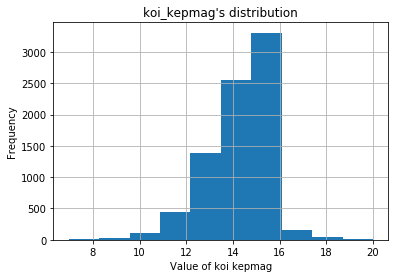

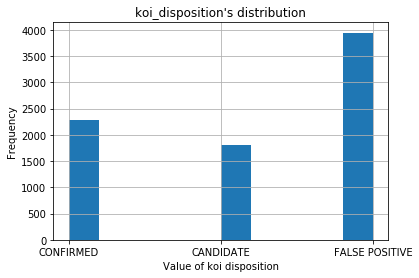

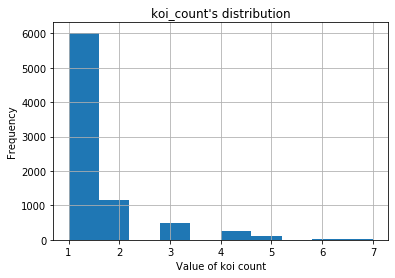

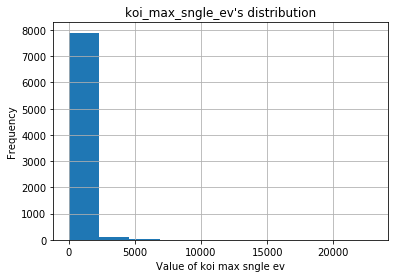

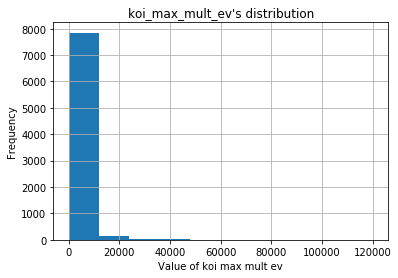

...

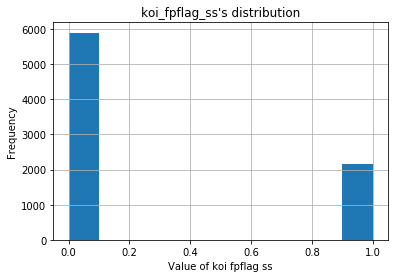

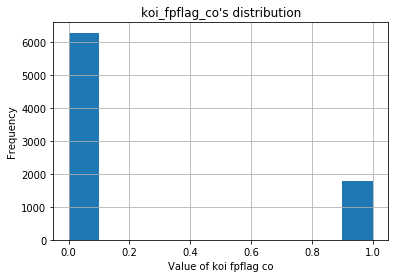

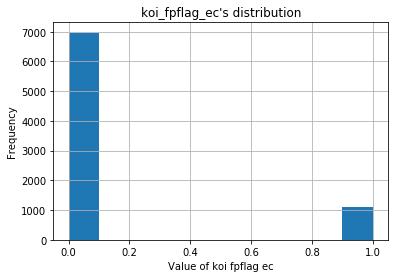

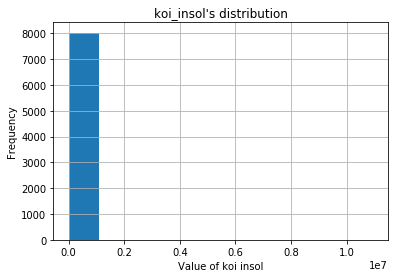

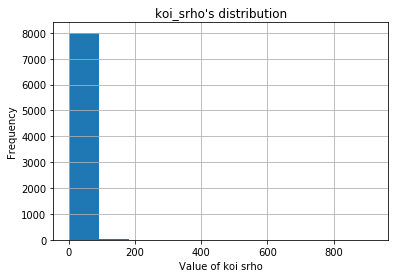

In [61]:
# A quick way to get an overview of the spread of data in each column
for a in koi_no_error.columns:
    koi_no_error[a].hist()
    plt.ylabel('Frequency')
    plt.title(a+"'s distribution")
    plt.xlabel('Value of '+a.replace('_',' '))

    plt.show()

In [59]:
#koi_no_error[koi_no_error< koi_no_error[large_values].quantile(.9)]

In [62]:

koi_v7 = koi_no_error.dropna()

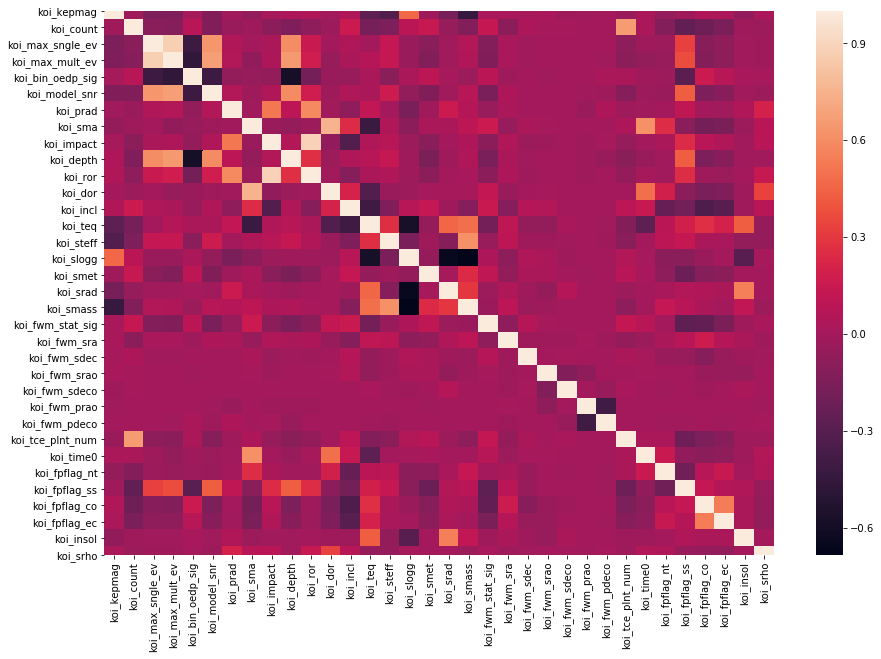

In [63]:
# I have produced a heat map to look for any correlation
# There aren't many variables with correlation:
# There is high correlation between KOI_MAX_SNGLE_EV and KOI_MAX_MULT_EV but this is because that the second is 
# just the first test repeated
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(koi_v7.corr());

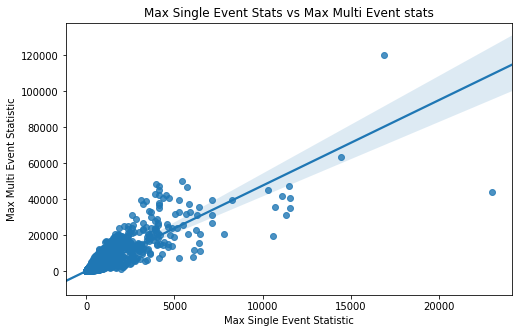

In [64]:
# An example of correlation between two variables where Single Event testing is plotted against Multi event 
# testing, I high score in the Single Event Testing should prove to be high in the Multi Event Testing.
# This is shown in the plot

fig, ax = plt.subplots(figsize=(8,5))

plt.title('Max Single Event Stats vs Max Multi Event stats')


sns.regplot(koi_v7.koi_max_sngle_ev, koi_v7.koi_max_mult_ev,ax=ax)
plt.xlabel('Max Single Event Statistic')
plt.ylabel('Max Multi Event Statistic')
plt.show()

In [65]:
# The shape of the data which I am happy with and will now model this data
koi_v7.shape

(7988, 35)

## Decision Tree Model - Standard Scaler

In [66]:
target = koi_v7.pop('koi_disposition')

In [67]:
# The baseline score
target.value_counts(normalize=True)

FALSE POSITIVE    0.486980
CONFIRMED         0.286805
CANDIDATE         0.226214
Name: koi_disposition, dtype: float64

In [68]:
# Initialising the standard scaler
scaler = StandardScaler()

In [69]:
# Splitting the data in an 80/20 split - I have stratified the y values so that there is a 
x_train, x_test, y_train, y_test = train_test_split(koi_v7, target, stratify=target, test_size = .2, random_state=1)

In [70]:
x_train_std = pd.DataFrame(scaler.fit_transform(x_train), columns=x_train.columns)

/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:625: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/anaconda3/lib/python3.7/site-packages/sklearn/base.py:462: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


In [71]:
x_test_std = pd.DataFrame(scaler.transform(x_test), columns=x_train.columns)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  """Entry point for launching an IPython kernel.


In [72]:
dtc = DecisionTreeClassifier(random_state=1)

In [73]:
dtc.fit(x_train_std, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [74]:
print('Decision Tree Classifier score:',dtc.score(x_test_std, y_test))

Decision Tree Classifier score: 0.8704630788485607


In [75]:
print('Cross evaluated mean with 5 folds:',cross_val_score(dtc, x_train_std, y_train, cv=5).mean())

Cross evaluated mean with 5 folds: 0.854617985415603


In [76]:
# The parameters I will change with the gridsearch 
dtc_params = {'criterion':['gini','entropy'], 
               'splitter':['best','random'], 
              'max_depth':[3,5,10], 
               'min_samples_split':[2], 
               'min_samples_leaf':[1,3], 
              
               'max_features':[None,'auto','sqrt'], 
            
              }

dtc_search = GridSearchCV(dtc, 
                           dtc_params,
                           n_jobs=2, 
                            cv=5, 
                            verbose=True, 
                            return_train_score=True)
dtc_search.fit(x_train_std, y_train)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done 360 out of 360 | elapsed:    7.3s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best'),
       fit_params=None, iid='warn', n_jobs=2,
       param_grid={'criterion': ['gini', 'entropy'], 'splitter': ['best', 'random'], 'max_depth': [3, 5, 10], 'min_samples_split': [2], 'min_samples_leaf': [1, 3], 'max_features': [None, 'auto', 'sqrt']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=True)

In [77]:
dtc_search.best_params_

{'criterion': 'entropy',
 'max_depth': 10,
 'max_features': None,
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'splitter': 'best'}

In [78]:
dtc_search.score(x_test_std, y_test)

0.8879849812265331

In [79]:
# To visualise and understand a how the decision tree with nodepth looks like
nodepth_dtc = DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [80]:
nodepth_dtc.fit(x_train_std, y_train)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [81]:
nodepth_dtc.score(x_train_std, y_train)

0.9841940532081377

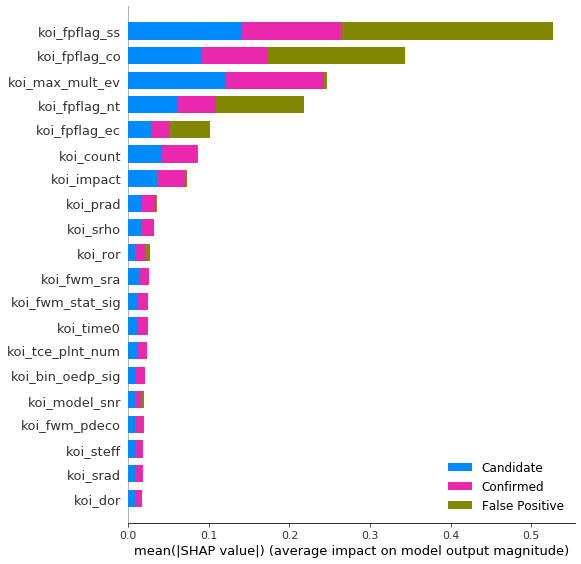

In [82]:
no_depth_explainer = shap.TreeExplainer(nodepth_dtc)
no_depth_shap_values = no_depth_explainer.shap_values(x_test_std)
shap.summary_plot(no_depth_shap_values, x_test_std, plot_type="bar",class_names=['Candidate','Confirmed','False Positive'])

In [83]:
# Clear signs of over fitting, to confirm this I will print the decision tree

In [84]:
# Export as dot file
export_graphviz(nodepth_dtc, out_file='nodepth_tree.dot', 
                feature_names = x_test_std.columns,
                class_names = target.unique(),
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)

call(['dot', '-Tpng', 'nodepth_tree.dot', '-o', 'nodepth_tree.png', '-Gdpi=600'])

# Display in jupyter notebook

Image(filename = 'nodepth_tree.png')

In [85]:
best_dtc = DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=10,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [86]:
best_dtc.fit(x_train_std, y_train)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=10,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [87]:
print('The Cross Validated Score is:',cross_val_score(best_dtc, x_train_std, y_train, cv=5).mean())

The Cross Validated Score is: 0.8859155576334963


In [88]:
print('The best Score is:',best_dtc.score(x_test_std, y_test))

The best Score is: 0.8879849812265331


In [93]:
conmat = confusion_matrix(y_test, best_dtc.predict(x_test_std))

In [94]:
conmat

array([[250, 111,   1],
       [ 64, 394,   0],
       [  0,   3, 775]])

In [95]:
y_test.value_counts()

FALSE POSITIVE    778
CONFIRMED         458
CANDIDATE         362
Name: koi_disposition, dtype: int64

In [96]:
confusion = pd.DataFrame(conmat, index=['is_CANDIDATE', 'is_CONFIRMED','is_FALSE_POSITIVE'],
                         columns=['predicted_CANDIDATE', 'predicted_CONFIRMED','predicted_FALSE_POSITIVE'])
confusion

,predicted_CANDIDATE,predicted_CONFIRMED,predicted_FALSE_POSITIVE
is_CANDIDATE,250,111,1
is_CONFIRMED,64,394,0
is_FALSE_POSITIVE,0,3,775


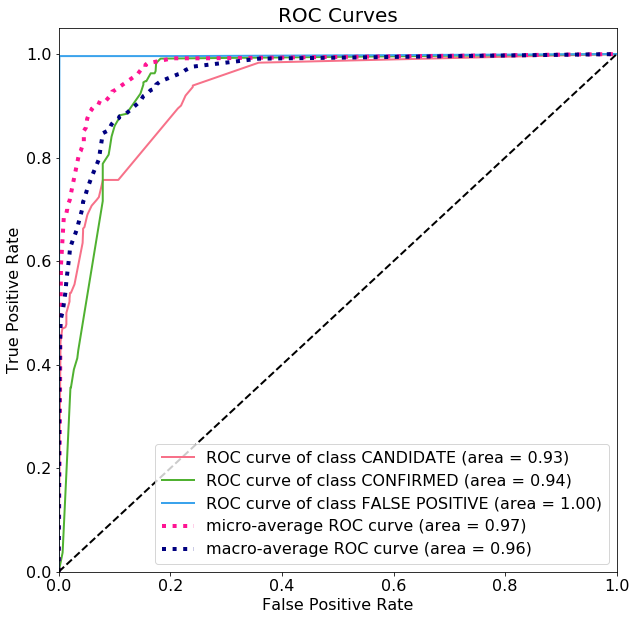

In [97]:
# The ROC Curve for the best Decision Tree Classifier - to understand what the difference between the 
# classification of Candidate and Confirmed and how I will adapt the model to accomodate this.

fig, ax = plt.subplots(figsize=(10,10))
skplt.metrics.plot_roc(y_test, dtc_search.predict_proba(x_test_std), plot_micro=True, plot_macro=True, 
                       title_fontsize=20, text_fontsize=16, figsize=(8,6), cmap=cmap, ax=ax)
#plt.legend(loc='lower right')
plt.show()

In [102]:
# Set up the array with all the probabilities for either classification 
predictons = best_dtc.predict(x_test_std)
star_prob = best_dtc.predict_proba(x_test_std)
#star_prob = pd.DataFrame(star_prob, columns= ['class_0','class_1','class_2'])

In [103]:
star_prob

array([[0.        , 0.        , 1.        ],
       [0.        , 0.        , 1.        ],
       [0.53846154, 0.46153846, 0.        ],
       ...,
       [0.22933333, 0.76933333, 0.00133333],
       [1.        , 0.        , 0.        ],
       [0.22933333, 0.76933333, 0.00133333]])

In [104]:
# To utilise SHAP you need to set up the explainer and then obtain the shape values from the explainer.
# This is necessary to get the SHAP graph running

explainer = shap.TreeExplainer(best_dtc)
shap_values = explainer.shap_values(x_test_std)



In [105]:
#shap.force_plot(explainer.expected_value[0], shap_values[0], features= x_test_std.columns)#,x_test_std.iloc[0,:])

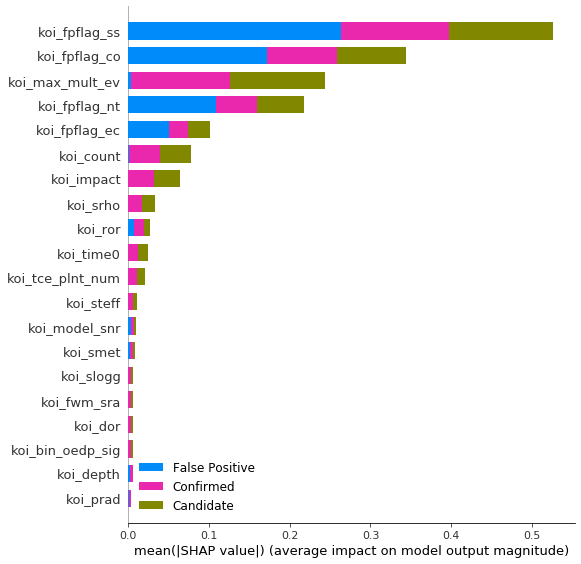

In [106]:
# An overview of the importance of the variables and how they impacted the classification of the datapoint
shap.summary_plot(shap_values, x_test_std, plot_type="bar",
                  class_names=['Candidate','Confirmed','False Positive'])

In [107]:
shap_values[2]

array([[ 0.00000000e+00,  3.45181220e-04,  0.00000000e+00, ...,
         1.84550214e-01,  0.00000000e+00,  9.31203159e-05],
       [ 0.00000000e+00,  1.18996251e-04,  0.00000000e+00, ...,
        -6.18852922e-03,  0.00000000e+00,  4.67573244e-04],
       [ 0.00000000e+00,  1.53284539e-04,  0.00000000e+00, ...,
        -1.41284482e-02,  0.00000000e+00, -9.17180244e-05],
       ...,
       [ 0.00000000e+00,  4.28114745e-04,  0.00000000e+00, ...,
        -1.41211531e-02,  0.00000000e+00,  1.40004279e-04],
       [ 0.00000000e+00,  1.53284539e-04,  0.00000000e+00, ...,
        -2.81104904e-02,  0.00000000e+00, -9.17180244e-05],
       [ 0.00000000e+00,  4.28114745e-04,  0.00000000e+00, ...,
        -1.41211531e-02,  0.00000000e+00,  1.40004279e-04]])

In [108]:
# Displaying the Decision Tree Map

# Export as dot file
export_graphviz(best_dtc, out_file='tree.dot', 
                feature_names = x_test_std.columns,
                class_names = target.unique(),
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)

call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook

Image(filename = 'tree.png')

## Logistic Regression

In [109]:
# I wanted to test a Logistic Regression to ensure that the tree classification was the best direction
# to pursue

In [110]:
log = LogisticRegression(solver='liblinear', random_state=1, max_iter=1500,multi_class='ovr')

In [111]:
log.fit(x_train_std, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=1500, multi_class='ovr',
          n_jobs=None, penalty='l2', random_state=1, solver='liblinear',
          tol=0.0001, verbose=0, warm_start=False)

In [112]:
print("Logistic Regression score:",log.score(x_test_std, y_test))

Logistic Regression score: 0.844180225281602


In [113]:
print('Cross evaluated score, with 5 folds:',cross_val_score(log, x_train_std, y_train, cv=5).mean())

Cross evaluated score, with 5 folds: 0.841314475613183


In [114]:
log_base =LogisticRegression(penalty='l2',random_state=1, max_iter=1500, multi_class='ovr')

In [115]:
# Setting up the Logistic Regression Gridsearch

log_params = {
               'C':[1,3,5,10], 
              'solver':['lbfgs','liblinear','sag'], 
     
            
              }

log_search = GridSearchCV(log_base, 
                           log_params,
                           n_jobs=2, 
                            cv=5, 
                            verbose=True, 
                            return_train_score=True)
log_search.fit(x_train_std, y_train)

Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  46 tasks      | elapsed:  1.7min
[Parallel(n_jobs=2)]: Done  60 out of  60 | elapsed:  2.5min finished
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/sag.py:334: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/sag.py:334: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=1500, multi_class='ovr',
          n_jobs=None, penalty='l2', random_state=1, solver='warn',
          tol=0.0001, verbose=0, warm_start=False),
       fit_params=None, iid='warn', n_jobs=2,
       param_grid={'C': [1, 3, 5, 10], 'solver': ['lbfgs', 'liblinear', 'sag']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=True)

In [116]:
print('Best cross evaluated score achieved with 5 folds:',log_search.best_score_)

Best cross evaluated score achieved with 5 folds: 0.8420970266040688


In [117]:
print('The best score, using Logistic Regression :',log_search.score(x_test_std,y_test))

The best score, using Logistic Regression : 0.8448060075093867


## Random Forest Tree

After utilising and seeing how effective the Decision Tree Classifier was I am now going to pursue the Random Tree Classifier and evaluate its effectiveness

In [118]:
rtc = RandomForestClassifier(random_state=1)

In [119]:
rtc.fit(x_train_std, y_train)

/anaconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [121]:
print('Cross evaluated score, with 5 folds:',cross_val_score(rtc, x_train_std, y_train, cv=5).mean())

Cross evaluated score, with 5 folds: 0.8820062531063704


In [122]:
print('Random Forest Score:',rtc.score(x_test_std, y_test))

Random Forest Score: 0.8948685857321652


In [123]:
# Setting up the Random Forest gridsearch

rtc_params = {
    'n_estimators':[50,100], 
     'criterion':['gini','entropy'], 
     'max_depth':[10,20,None], 
     'min_samples_split':[2], 
     'min_samples_leaf':[1,3], 
#     'min_weight_fraction_leaf':[0.0], 
     'max_features':[None,'auto','sqrt'], 
 
     
     
     
}

rtc_search = GridSearchCV(rtc, 
                           rtc_params,
                           n_jobs=2, 
                            cv=5, 
                            verbose=3, 
                            return_train_score=True)
rtc_search.fit(x_train_std, y_train)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  28 tasks      | elapsed:  1.3min
[Parallel(n_jobs=2)]: Done 124 tasks      | elapsed:  3.4min
[Parallel(n_jobs=2)]: Done 284 tasks      | elapsed:  7.5min
[Parallel(n_jobs=2)]: Done 360 out of 360 | elapsed:  9.1min finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False),
       fit_params=None, iid='warn', n_jobs=2,
       param_grid={'n_estimators': [50, 100], 'criterion': ['gini', 'entropy'], 'max_depth': [10, 20, None], 'min_samples_split': [2], 'min_samples_leaf': [1, 3], 'max_features': [None, 'auto', 'sqrt']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=3)

In [124]:
rtc_search.best_params_

{'criterion': 'entropy',
 'max_depth': 20,
 'max_features': None,
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'n_estimators': 50}

In [125]:
print('The best gridsearched Random Forest score:',rtc_search.best_score_)

The best gridsearched Random Forest score: 0.9042253521126761


In [126]:
print('The best score for the Random Forest:', rtc_search.score(x_test_std, y_test))

The best score for the Random Forest: 0.9167709637046307


In [127]:
# The best parameters from the random forest gridsearch

best_rtc = RandomForestClassifier(bootstrap=True, class_weight=None, criterion='entropy',
            max_depth=20, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [128]:
best_rtc.fit(x_train_std,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='entropy',
            max_depth=20, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [129]:
best_rtc.score(x_test_std, y_test)

0.9167709637046307

In [130]:
# Observing the probabilites for each datapoint 

best_rtc.predict_proba(x_test_std)

array([[0.        , 0.        , 1.        ],
       [0.        , 0.        , 1.        ],
       [0.89666667, 0.10333333, 0.        ],
       ...,
       [0.23097384, 0.76902616, 0.        ],
       [0.87806061, 0.12193939, 0.        ],
       [0.19764106, 0.80235894, 0.        ]])

In [131]:
target.unique()

array(['CONFIRMED', 'CANDIDATE', 'FALSE POSITIVE'], dtype=object)

In [132]:
# Displaying the confusion matrix for the Random Forest Classifier

conmat_rtc = confusion_matrix(y_test, best_rtc.predict(x_test_std))

confusion_rtc = pd.DataFrame(conmat_rtc, index=['is_CANDIDATE', 'is_CONFIRMED','is_FALSE_POSITIVE'],
                         columns=['predicted_CANDIDATE', 'predicted_CONFIRMED','predicted_FALSE_POSITIVE'])
confusion_rtc


,predicted_CANDIDATE,predicted_CONFIRMED,predicted_FALSE_POSITIVE
is_CANDIDATE,276,85,1
is_CONFIRMED,46,411,1
is_FALSE_POSITIVE,0,0,778


In [133]:
# I can see that there is a smaller mis classification between the Confirmed and Candidate, this is a great
# positive despite having a small amount predicted as False Positive

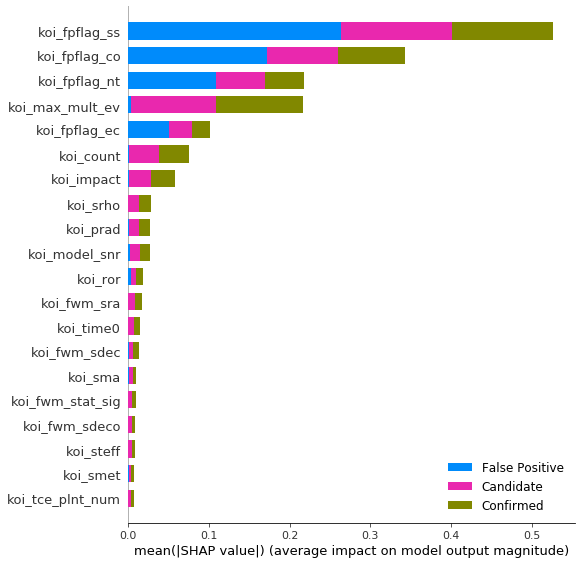

In [134]:
# Looking into the SHAP graph for the best Random Forest Classifier

rtc_explainer = shap.TreeExplainer(best_rtc)
shap_values = rtc_explainer.shap_values(x_test_std)
shap.summary_plot(shap_values, x_test_std, plot_type="bar",class_names=['Candidate','Confirmed','False Positive'])

## Principle Component Analysis 

In [155]:
pca = PCA(n_components=30)

In [156]:
cols = ['PC_{}'.format(i) for i in range(1, pca.n_components+1)]
x_train_pca_std = pd.DataFrame(pca.fit_transform(x_train_std), columns=cols)
x_train_pca_std.head()

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,PC_27,PC_28,PC_29,PC_30
0,-1.064855,0.986554,-2.071101,0.101262,-1.219779,0.956605,0.096501,0.236182,0.163990,0.258264,1.041907,-0.922831,2.123515,-0.733168,-0.630054,0.704611,0.621456,-0.711760,1.087693,-0.077529,-0.655129,-0.390689,-0.097773,-0.011027,-0.365357,-0.344496,-0.151584,0.262959,0.083818,0.186019
1,-0.648391,-0.006781,0.389432,-0.851196,1.120465,-0.544129,-0.027057,-0.233216,0.113917,-0.550339,-0.683027,1.679856,0.390369,0.484056,0.380343,-0.682008,-0.670112,-0.492457,-0.114339,0.011025,0.738087,0.373241,-0.128857,0.160433,-0.501680,-0.312292,-0.217401,-1.250509,-0.256695,-0.000878
2,-1.478411,-0.801889,0.815967,-0.187308,0.927630,-0.192661,-0.148098,0.238010,0.098383,-0.411596,-0.581854,0.725714,0.127873,0.827116,-0.436367,-0.157718,0.437551,-0.208564,-0.193512,-0.180218,-0.157043,0.088842,-0.224205,0.016331,-0.109462,-0.077769,0.530568,0.327633,-0.179707,0.314549
3,-2.742347,-2.473038,3.618886,2.062222,-2.015232,0.003122,-0.452695,1.769789,0.049755,0.564457,-1.782442,-0.402882,-0.712361,1.535677,-1.450139,1.241727,0.650018,0.375842,-0.035562,-0.034115,-0.611671,0.378459,0.734008,-1.077467,1.510168,0.742372,0.738048,0.316666,0.081330,0.223211
4,-1.257809,-0.437988,0.081285,0.091935,0.459366,0.063858,0.259015,-1.183613,0.109290,0.531082,0.263237,-1.109091,0.407430,0.455242,-1.122252,0.286267,0.120860,0.206739,-0.000233,-0.034472,-0.178998,-0.107410,-0.133569,-0.070420,-0.062905,-0.106957,0.284223,0.161558,0.137254,0.277482


In [157]:
cols = ['PC_{}'.format(i) for i in range(1, pca.n_components+1)]
x_test_pca_std = pd.DataFrame(pca.transform(x_test_std), columns=cols)
x_test_pca_std.head()

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17,PC_18,PC_19,PC_20,PC_21,PC_22,PC_23,PC_24,PC_25,PC_26,PC_27,PC_28,PC_29,PC_30
0,0.141557,2.804616,-2.711585,1.736190,-2.501634,-0.219745,-0.501713,2.683391,-0.012861,2.340175,-1.027743,-0.473024,1.284565,0.643056,-0.505835,0.020016,-0.562358,1.347651,-1.066302,0.019831,-0.360424,0.048669,0.151953,0.482796,-0.733292,-0.537707,-0.052350,-0.171591,0.484128,0.497207
1,3.265710,-0.069493,-1.529765,7.378765,3.465026,-2.005992,0.004857,-1.096942,0.524406,-1.401360,-1.163080,-1.707737,0.562847,-0.043801,-0.536719,0.368668,-0.947554,1.007339,0.249758,0.712731,1.976191,-1.564150,-0.964644,-1.809546,-0.349483,0.290312,-0.254286,0.105250,0.130136,-0.711549
2,-1.272137,-0.511227,0.065272,-0.194019,0.295823,0.248308,0.247123,-1.349496,0.064866,0.779227,-0.416038,1.240824,0.019277,0.488592,-0.119829,0.207552,0.241320,0.080388,-0.163550,-0.038923,0.183183,-0.121585,-0.077757,0.118310,-0.054358,-0.020522,0.185221,0.130926,0.034579,-0.051359
3,0.007093,-0.577965,-0.870794,0.968729,-0.650438,0.183735,0.412222,0.710206,0.005257,1.759344,-1.319481,0.161085,-0.660722,0.645460,0.238178,-0.889185,-1.593796,-0.137624,0.921368,-0.530923,-1.013080,-1.245904,0.400840,-0.578216,-0.047234,0.070025,0.150902,-0.443023,0.124744,-0.075690
4,-1.650285,-1.051911,-1.599372,-0.414823,0.746797,1.696921,-0.030638,0.166681,-0.061430,1.023313,0.091365,-1.688087,-0.112203,-1.388270,0.456503,-0.032832,-0.348465,-0.690628,-0.043745,0.144933,0.101747,0.450159,-0.100324,-0.076274,-0.068211,-0.130618,-0.340517,-0.368073,-0.378827,0.055972


In [158]:
print("Number of principal components:\t\t", pca.n_components_)
print("Explained variance:\t\t\t", np.round(pca.explained_variance_, 3))
print("Explained variance ratio:\t\t", np.round(
    pca.explained_variance_ratio_, 3))
print("Cumulative explained variance ratio:\t", np.round(
    np.cumsum(pca.explained_variance_ratio_), 3))

Number of principal components:		 30
Explained variance:			 [4.272 3.423 2.787 2.433 2.034 1.615 1.417 1.334 1.074 1.05  1.014 0.966
 0.952 0.928 0.915 0.835 0.756 0.704 0.665 0.587 0.557 0.5   0.456 0.426
 0.409 0.356 0.338 0.311 0.274 0.225]
Explained variance ratio:		 [0.126 0.101 0.082 0.072 0.06  0.048 0.042 0.039 0.032 0.031 0.03  0.028
 0.028 0.027 0.027 0.025 0.022 0.021 0.02  0.017 0.016 0.015 0.013 0.013
 0.012 0.01  0.01  0.009 0.008 0.007]
Cumulative explained variance ratio:	 [0.126 0.226 0.308 0.38  0.44  0.487 0.529 0.568 0.6   0.63  0.66  0.689
 0.717 0.744 0.771 0.795 0.818 0.838 0.858 0.875 0.892 0.906 0.92  0.932
 0.944 0.955 0.965 0.974 0.982 0.988]


In [159]:
exp_var = pca.explained_variance_ratio_

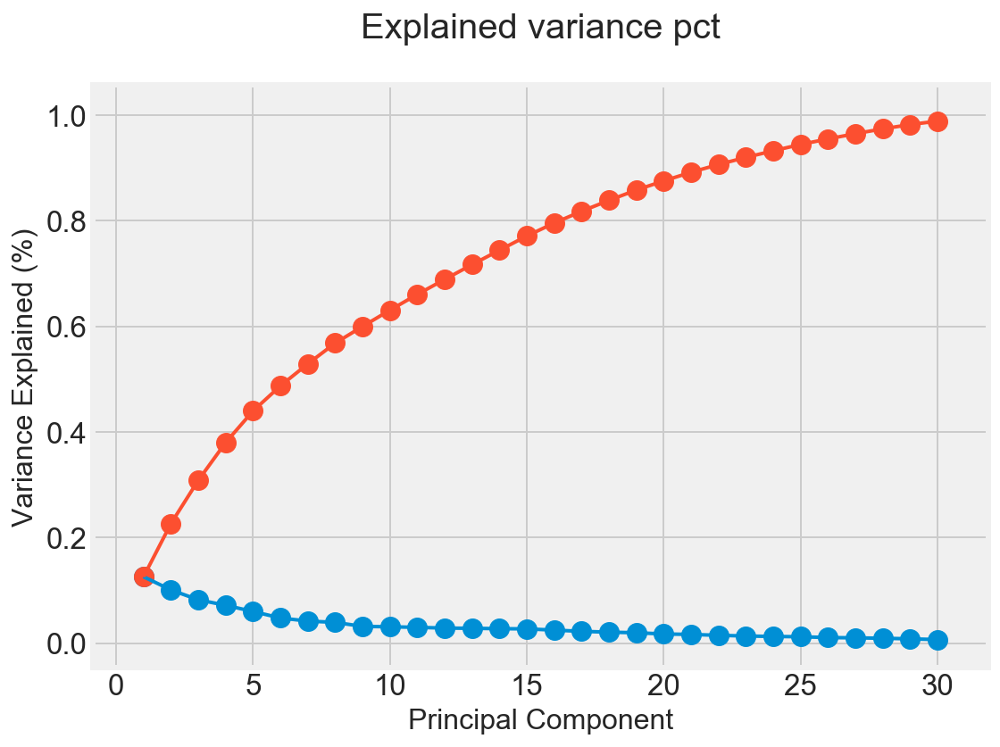

In [160]:
fig, ax = plt.subplots(figsize=(8, 6))
x_values = list(range(1, pca.n_components_+1))
ax.plot(x_values, exp_var, lw=2)
ax.scatter(x_values, exp_var, s=120)
ax.plot(x_values, np.cumsum(exp_var), lw=2)
ax.scatter(x_values, np.cumsum(exp_var), s=120)
ax.set_title('Explained variance pct\n', fontsize=20)
ax.set_xlabel('Principal Component', fontsize=16)
ax.set_ylabel('Variance Explained (%)', fontsize=16)
plt.show()

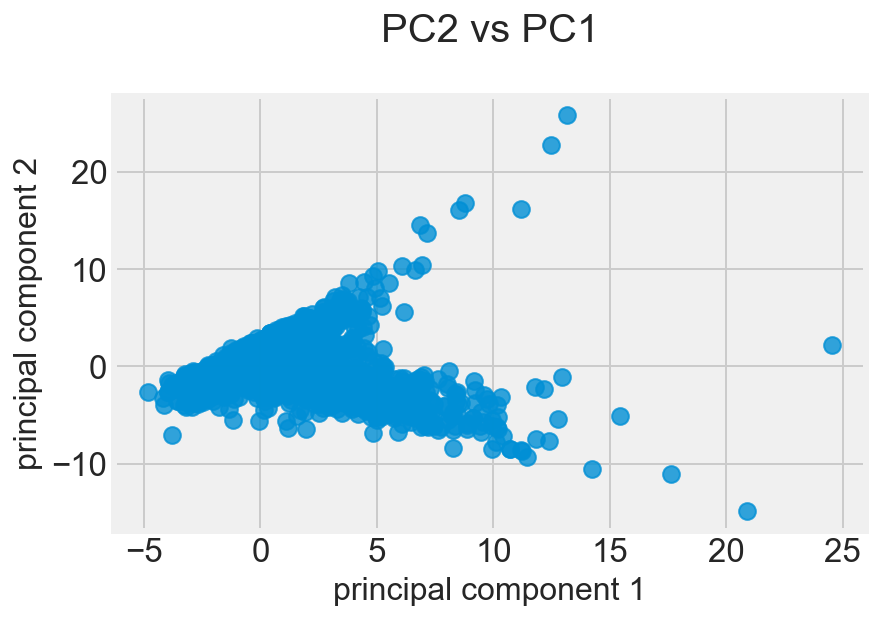

In [161]:
fig = plt.figure(figsize=(6, 4))

ax = fig.gca()
sns.regplot(x_train_pca_std.iloc[:, 0], x_train_pca_std.iloc[:, 1],
            fit_reg=False, scatter_kws={'s': 70}, ax=ax)

ax.set_xlabel('principal component 1', fontsize=16)
ax.set_ylabel('principal component 2', fontsize=16)

ax.set_title('PC2 vs PC1\n', fontsize=20)

plt.show()

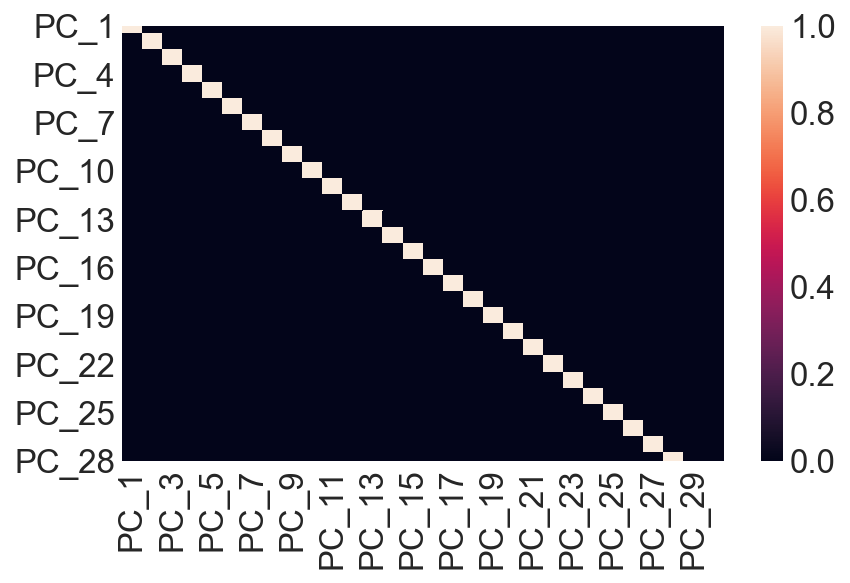

In [162]:
sns.heatmap(x_train_pca_std.corr());

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


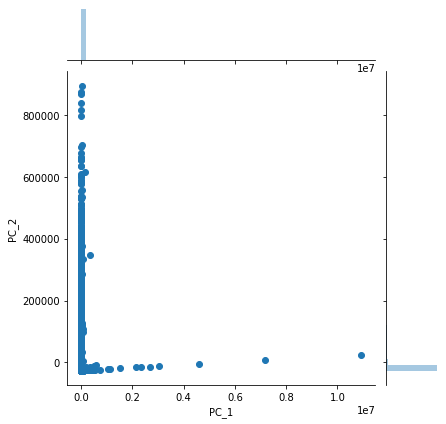

In [190]:
sns.jointplot(space_pca_v3.iloc[:,0],space_pca_v3.iloc[:,1]);

In [163]:
rtc_pca = RandomForestClassifier(random_state=1)

In [164]:
rtc_pca.fit(x_train_pca_std.iloc[:,:11], y_train)

/anaconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [166]:
cross_val_score(rtc_pca, x_train_pca_std.iloc[:,:11], y_train, cv=5).mean()

0.7783988712684647

In [167]:
rtc_pca.score(x_test_pca_std.iloc[:,:11], y_test)

0.7734668335419274

In [168]:
log_pca = LogisticRegression(random_state=1)

In [170]:
log_pca.fit(x_train_pca_std.iloc[:,:11], y_train)

/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=1, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)

In [172]:
log_pca.score(x_test_pca_std.iloc[:,:11], y_test)

0.7872340425531915

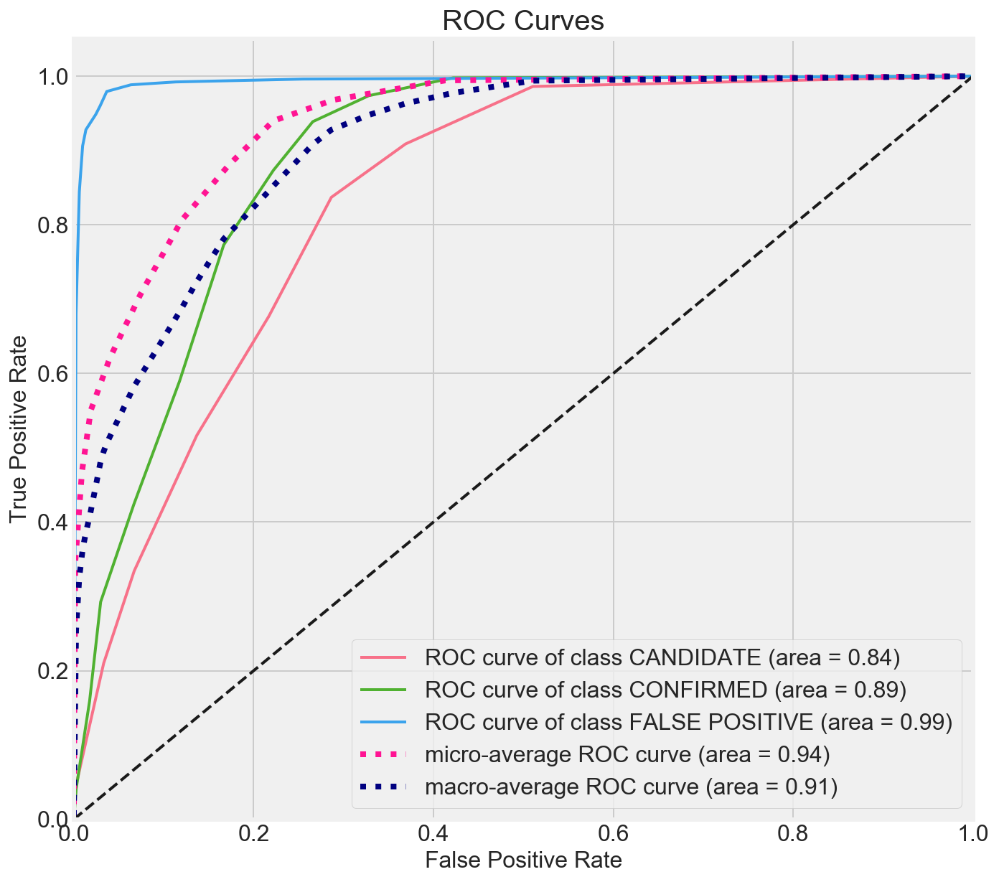

In [176]:
conmat_pca = confusion_matrix(y_test, rtc_pca.predict(x_test_pca_std.iloc[:,:11]))
confusion_pca = pd.DataFrame(conmat, index=['is_CANDIDATE', 'is_CONFIRMED','is_FALSE_POSITIVE'],
                         columns=['predicted_CANDIDATE', 'predicted_CONFIRMED','predicted_FALSE_POSITIVE'])

fig, ax = plt.subplots(figsize=(10,10))
skplt.metrics.plot_roc(y_test, rtc_pca.predict_proba(x_test_pca_std.iloc[:,:11]), plot_micro=True, plot_macro=True, 
                       title_fontsize=20, text_fontsize=16, figsize=(8,6), cmap=cmap, ax=ax)
#plt.legend(loc='lower right')
plt.show()

##  Normalized data test

In [177]:
# Normalising the data

koi_normal = pd.DataFrame(normalize(koi_v7), columns=koi_v7.columns)

In [178]:
koi_normal.head(1)

,koi_kepmag,koi_count,koi_max_sngle_ev,koi_max_mult_ev,koi_bin_oedp_sig,koi_model_snr,koi_prad,koi_sma,koi_impact,koi_depth,koi_ror,koi_dor,koi_incl,koi_teq,koi_steff,koi_slogg,koi_smet,koi_srad,koi_smass,koi_fwm_stat_sig,koi_fwm_sra,koi_fwm_sdec,koi_fwm_srao,koi_fwm_sdeco,koi_fwm_prao,koi_fwm_pdeco,koi_tce_plnt_num,koi_time0,koi_fpflag_nt,koi_fpflag_ss,koi_fpflag_co,koi_fpflag_ec,koi_insol,koi_srho
0,0.000006,8.146607e-07,0.000002,0.000012,2.795916e-07,0.000015,9.205666e-07,3.474528e-08,5.947023e-08,0.000251,9.101389e-09,0.00001,0.000037,0.000323,0.002222,0.000002,5.702625e-08,3.775952e-07,3.743366e-07,8.146607e-10,0.000008,0.00002,1.751520e-07,3.828905e-07,-8.146607e-11,-2.240317e-10,4.073303e-07,0.999997,0.0,0.0,0.0,0.0,0.000038,0.000001


In [179]:
x_train_nor, x_test_nor, y_train_nor, y_test_nor = train_test_split(koi_normal, target, stratify=target,
                                                                    random_state=1, test_size=.2)

In [180]:
scaler_normal = StandardScaler()

In [181]:
x_train_std_nor = pd.DataFrame(scaler_normal.fit_transform(x_train_nor), columns=x_train_nor.columns)

In [182]:
x_test_std_nor = pd.DataFrame(scaler_normal.transform(x_test_nor), columns=x_test_nor.columns)

### Decision Tree Classifier

In [183]:
dtc_nor = DecisionTreeClassifier(random_state=1)

In [184]:
dtc_nor_params = {'criterion':['gini','entropy'], 
               'splitter':['best','random'], 
              'max_depth':[5,10,15], 
               'min_samples_split':[2], 
               'min_samples_leaf':[1,3], 
              
               'max_features':[None,'auto','sqrt'], 
            
              }

dtc_nor_search = GridSearchCV(dtc_nor, 
                           dtc_nor_params,
                           n_jobs=2, 
                            cv=5, 
                            verbose=3, 
                            return_train_score=True)
dtc_nor_search.fit(x_train_std_nor, y_train_nor)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  53 tasks      | elapsed:    2.7s
[Parallel(n_jobs=2)]: Done 357 out of 360 | elapsed:    9.2s remaining:    0.1s
[Parallel(n_jobs=2)]: Done 360 out of 360 | elapsed:    9.2s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best'),
       fit_params=None, iid='warn', n_jobs=2,
       param_grid={'criterion': ['gini', 'entropy'], 'splitter': ['best', 'random'], 'max_depth': [5, 10, 15], 'min_samples_split': [2], 'min_samples_leaf': [1, 3], 'max_features': [None, 'auto', 'sqrt']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=3)

In [185]:
dtc_nor_search.best_params_

{'criterion': 'entropy',
 'max_depth': 10,
 'max_features': None,
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'splitter': 'best'}

In [186]:
normalised_dtc_search  = DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=10,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [189]:
normalised_dtc_search.fit(x_train_std_nor, y_train_nor)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=10,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=1,
            splitter='best')

In [190]:
print('The Cross Validated Score:',cross_val_score(normalised_dtc_search, x_train_std_nor, y_train_nor, cv=5).mean())

The Cross Validated Score: 0.8826334570660913


In [191]:
print('The test score:',normalised_dtc_search.score(x_test_std_nor, y_test_nor))

The test score: 0.8942428035043805


### Logistic Regression

In [199]:
log_normal = LogisticRegression(solver='liblinear',multi_class='ovr',random_state=1)

In [200]:
log_normal.fit(x_train_std_nor, y_train_nor)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr',
          n_jobs=None, penalty='l2', random_state=1, solver='liblinear',
          tol=0.0001, verbose=0, warm_start=False)

In [201]:
print('The Logistic Regression Test score:',log_normal.score(x_test_std_nor,y_test_nor))

The Logistic Regression Test score: 0.844180225281602


In [202]:
print('The crossvalidated training score:',cross_val_score(log_normal, x_train_std_nor, y_train_nor, cv=5).mean())

The crossvalidated training score: 0.8416274648501982


### Support Machine Vector

In [101]:
support = SVC(random_state=1)

In [102]:
support.fit(x_train_std_nor, y_train_nor)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=False, random_state=1,
  shrinking=True, tol=0.001, verbose=False)

In [103]:
support.score(x_test_std_nor, y_test_nor)

0.8391739674593242

In [104]:
support_params = {'C':[1,3,5], 
               'kernel':['rbf','sigmoid'], 
              'degree':[2,3,5], 
               'gamma':[2,5,'auto'], 

            
              }

support_search = GridSearchCV(support, 
                           support_params,
                           n_jobs=2, 
                            cv=5, 
                            verbose=True, 
                            return_train_score=True)
support_search.fit(x_train_std_nor, y_train_nor)

Fitting 5 folds for each of 54 candidates, totalling 270 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  46 tasks      | elapsed:  1.2min
[Parallel(n_jobs=2)]: Done 196 tasks      | elapsed:  4.2min
[Parallel(n_jobs=2)]: Done 270 out of 270 | elapsed:  5.4min finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=False, random_state=1,
  shrinking=True, tol=0.001, verbose=False),
       fit_params=None, iid='warn', n_jobs=2,
       param_grid={'C': [1, 3, 5], 'kernel': ['rbf', 'sigmoid'], 'degree': [2, 3, 5], 'gamma': [2, 5, 'auto']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=True)

In [224]:
support_search.score(x_test_std_nor, y_test_nor)

0.8460575719649562

In [226]:
support_search.best_params_

{'C': 3, 'degree': 2, 'gamma': 'auto', 'kernel': 'rbf'}

In [228]:
support_best = SVC(C=3, degree=2, gamma='auto',kernel='rbf',random_state=1)

In [229]:
support_best.fit(x_train_std_nor, y_train_nor)

SVC(C=3, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=2, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=1, shrinking=True,
  tol=0.001, verbose=False)

In [231]:
cross_val_score(support_best, x_train_std_nor, y_train_nor, cv=5).mean()

0.8403750171329655

### Random Tree Classifier

In [204]:
random_normal = RandomForestClassifier(n_estimators=10,random_state=1)

In [205]:
random_normal.fit(x_train_std_nor, y_train_nor)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [206]:
print('The normalised random forest score:',random_normal.score(x_test_std_nor, y_test_nor))

The normalised random forest score: 0.8936170212765957


In [207]:
rtc_v2_params = {
    'n_estimators':[50, 100, 150], 
     'criterion':['gini','entropy'], 
     'max_depth':[None,2,5,10], 
     'min_samples_split':[2], 
     'min_samples_leaf':[1,3],  
     'max_features':[None,'auto','sqrt'], 
 
     'oob_score':[False], 
     
     
}

rtc_v2_search = GridSearchCV(random_normal, 
                           rtc_v2_params,
                           n_jobs=2, 
                            cv=5, 
                            verbose=3, 
                            return_train_score=True)
rtc_v2_search.fit(x_train_std_nor, y_train_nor)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  28 tasks      | elapsed:  1.9min
[Parallel(n_jobs=2)]: Done 124 tasks      | elapsed:  3.3min
[Parallel(n_jobs=2)]: Done 284 tasks      | elapsed:  5.5min
[Parallel(n_jobs=2)]: Done 508 tasks      | elapsed: 11.7min
[Parallel(n_jobs=2)]: Done 720 out of 720 | elapsed: 16.8min finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False),
       fit_params=None, iid='warn', n_jobs=2,
       param_grid={'n_estimators': [50, 100, 150], 'criterion': ['gini', 'entropy'], 'max_depth': [None, 2, 5, 10], 'min_samples_split': [2], 'min_samples_leaf': [1, 3], 'max_features': [None, 'auto', 'sqrt'], 'oob_score': [False]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=3)

In [208]:
rtc_v2_search.best_params_

{'criterion': 'entropy',
 'max_depth': None,
 'max_features': None,
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'n_estimators': 100,
 'oob_score': False}

In [209]:
print('The best score for the normalised random forest:',rtc_v2_search.score(x_test_std_nor, y_test_nor))

The best score for the normalised random forest: 0.9167709637046307


In [210]:
best_nor_rtc = RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=10, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [211]:
best_nor_rtc.fit(x_train_std_nor, y_train_nor)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=10, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=1, verbose=0, warm_start=False)

In [212]:
cross_val_score(best_nor_rtc,x_train_std_nor, y_train_nor,cv=5).mean()

0.8787215815102292

##### Random Forest Boost

0.9995305164319249
0.9021912396060549
0.9086357947434293
0.9086357947434293


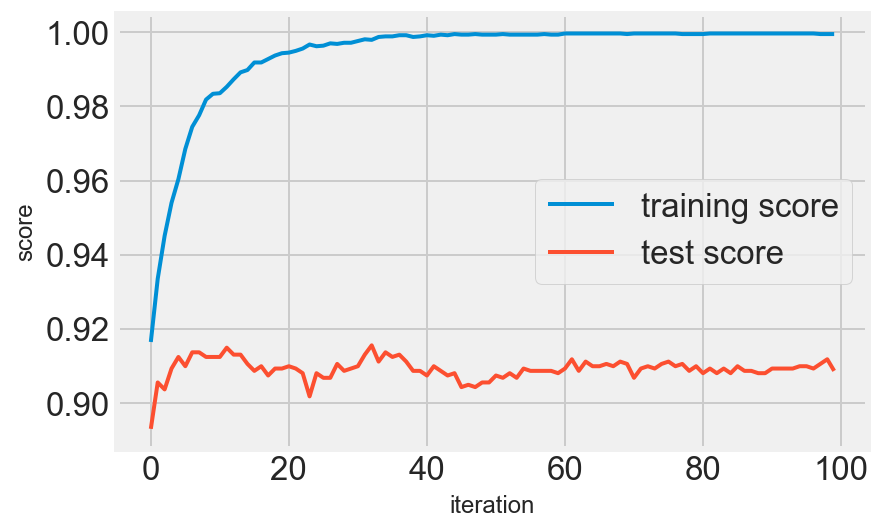

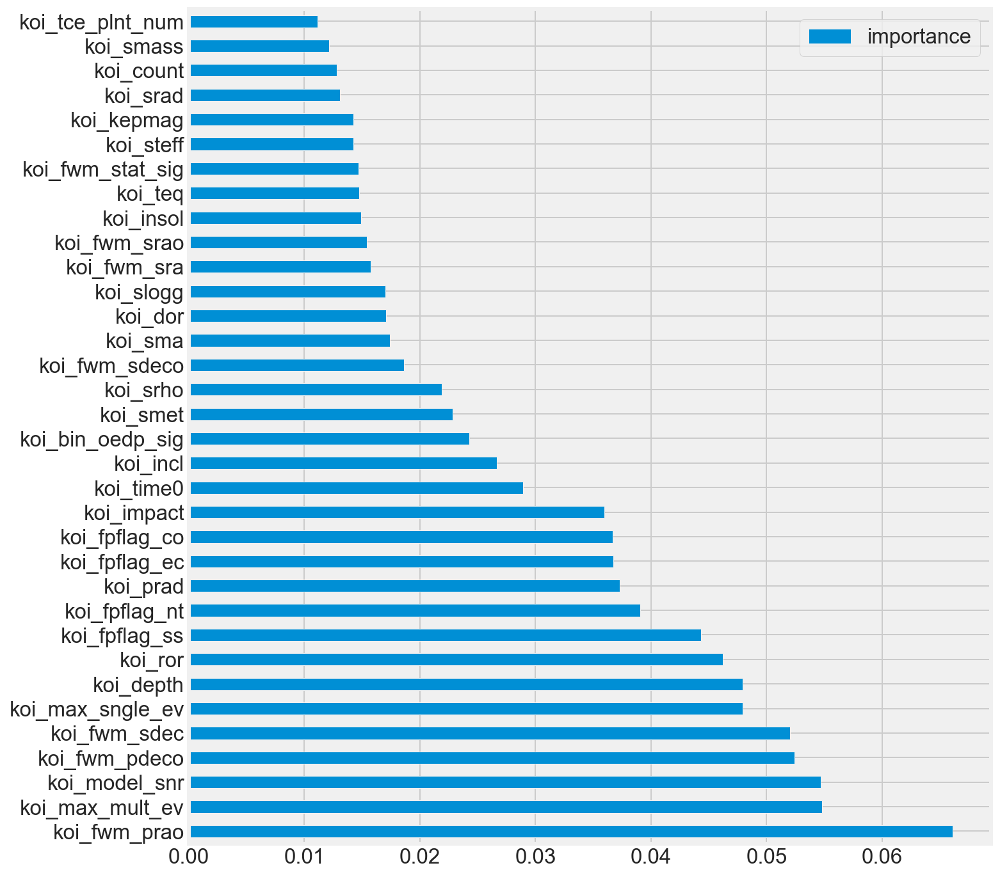

In [213]:
# I have used the AdaBoost classifier to see if I can get a better result than just the gridsearched random 
# forest classifier

model = AdaBoostClassifier(base_estimator=best_nor_rtc,
                           n_estimators=100,
                           random_state=1)
model.fit(x_train_std_nor, y_train_nor)

print(model.score(x_train_std_nor, y_train_nor))
print(cross_val_score(model, x_train_std_nor, y_train_nor, cv=5).mean())
print(model.score(x_test_std_nor, y_test_nor))
print(pd.DataFrame(model.staged_predict(x_test_std_nor)
                   ).T.apply(lambda x: accuracy_score(y_test_nor, x),
                             axis=0)[model.n_estimators-1])

plt.plot(list(model.staged_score(x_train_std_nor, y_train_nor)),
         label='training score', lw=2)
plt.plot(list(model.staged_score(x_test_std_nor, y_test_nor)), label='test score', lw=2)
plt.xlabel('iteration')
plt.ylabel('score')
plt.legend()
plt.show()

pd.DataFrame(model.feature_importances_,
             columns=['importance'],
             index=koi_v7.columns
             ).sort_values(by='importance', ascending=False
                           ).plot(kind='barh', figsize=(10, 12))
plt.show()

In [214]:
## I have observed that the top 5 variables are similar to that of the Decision Tree and Random Forest Classifier
## But it did not return a better score as well as capping out at about 40 iterations.

#### Gradient Boost

In [215]:
# I wanted to compare the results to the AdaBoost, to understand what the boosting models were looking at 
# in particular and to evaluate if there a key area to look into

grad_boost = GradientBoostingClassifier(n_estimators=100,
                                   criterion='mse',
                               
                                   max_depth=3,
                                   learning_rate=1.0,
                                   random_state=1)
grad_boost.fit(x_train_std_nor, y_train_nor)

print(grad_boost.score(x_train_std_nor, y_train_nor))
print(cross_val_score(grad_boost, x_train_std_nor, y_train_nor, cv=5).mean())
print(grad_boost.score(x_test_std_nor, y_test_nor))

1.0
0.8909221591735225
0.9005006257822278


In [216]:
## See if I can extract the parameters of the gradient boost

95    0.897997
96    0.898623
97    0.897997
98    0.899249
99    0.900501
dtype: float64


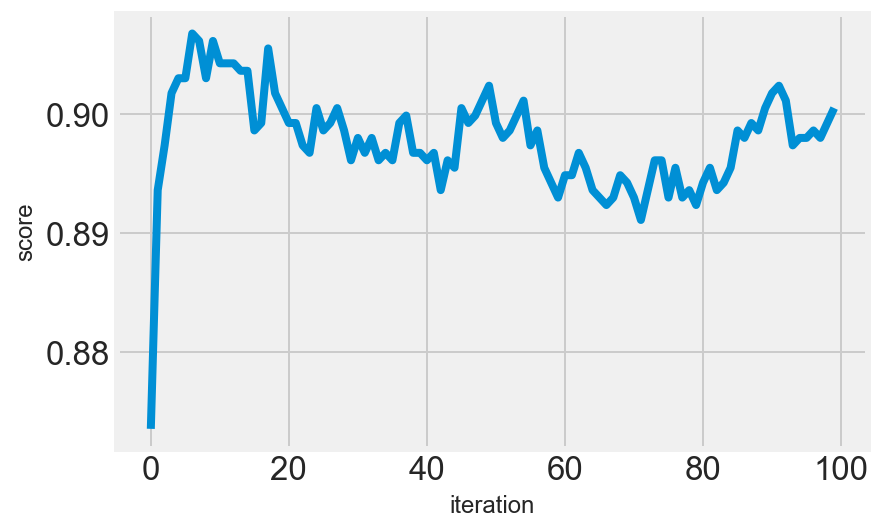

In [217]:
# I wanted to plot the scores as they changed over the course of the gradient boost model

scores = pd.DataFrame(grad_boost.staged_predict(x_test_std_nor)).T.apply(
    lambda x: accuracy_score(y_test_nor, x), axis=0)
print(scores.tail())
scores.plot()
plt.xlabel('iteration')
plt.ylabel('score')
plt.show()

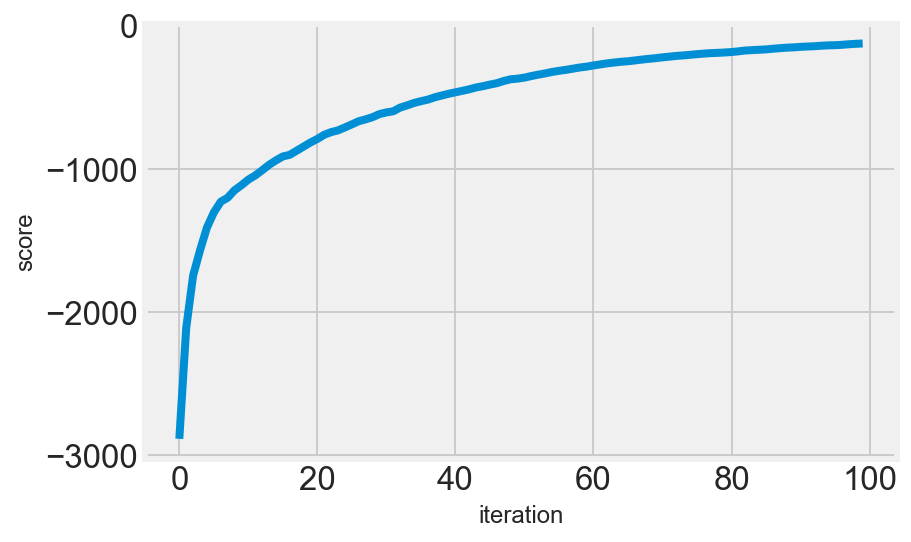

In [218]:

plt.plot(1-grad_boost.train_score_)
plt.xlabel('iteration')
plt.ylabel('score')
plt.show()

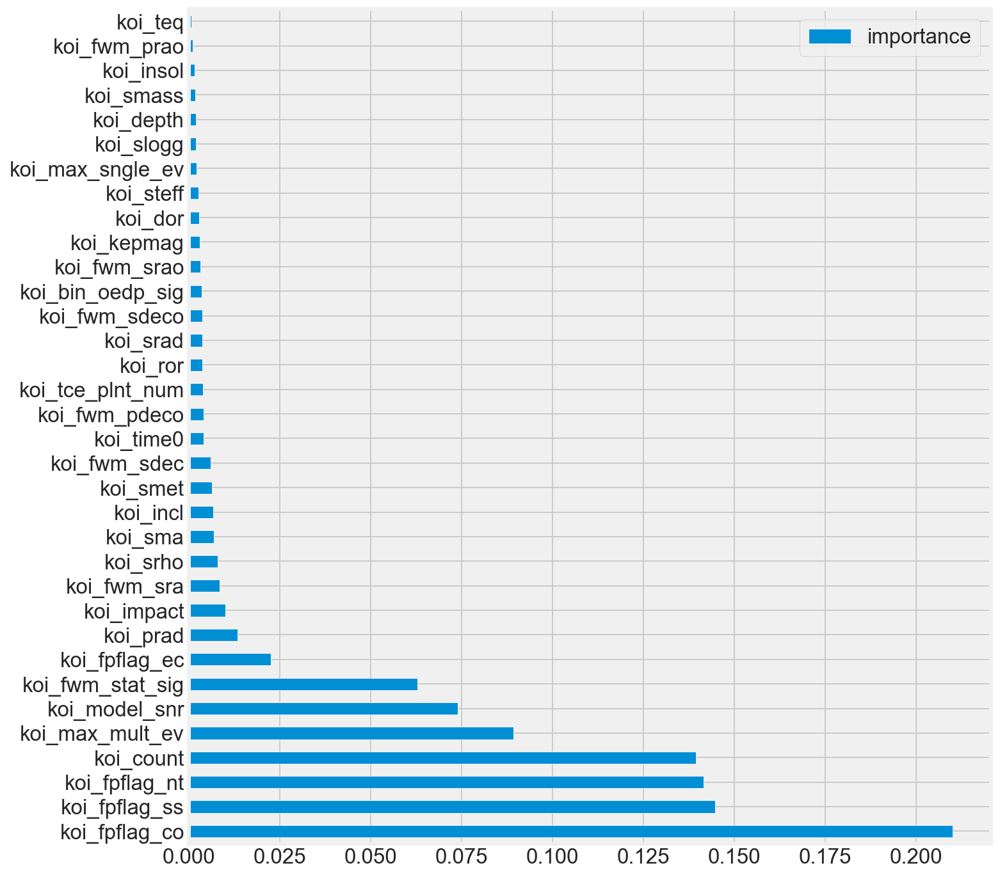

In [219]:
# Plotting how much of an impact each variable had in the gradient boost model, it was interesting to find
# that the top 5 variables were different this time around and that there was only a crossover of 1 variable.

pd.DataFrame(grad_boost.feature_importances_,
             columns=['importance'],
             index=x_train_std_nor.columns
             ).sort_values(by='importance', ascending=False
                           ).plot(kind='barh', figsize=(10, 12))
plt.show()

### Random Forest Continued

In [220]:
conmat_norm =  confusion_matrix(y_test_nor, best_nor_rtc.predict(x_test_std_nor))

In [221]:
confusion_normalised = pd.DataFrame(conmat_norm, index=['is_CANDIDATE', 'is_CONFIRMED','is_FALSE_POSITIVE'],
                         columns=['predicted_CANDIDATE', 'predicted_CONFIRMED','predicted_FALSE_POSITIVE'])
confusion_normalised

,predicted_CANDIDATE,predicted_CONFIRMED,predicted_FALSE_POSITIVE
is_CANDIDATE,253,95,14
is_CONFIRMED,53,403,2
is_FALSE_POSITIVE,1,3,774


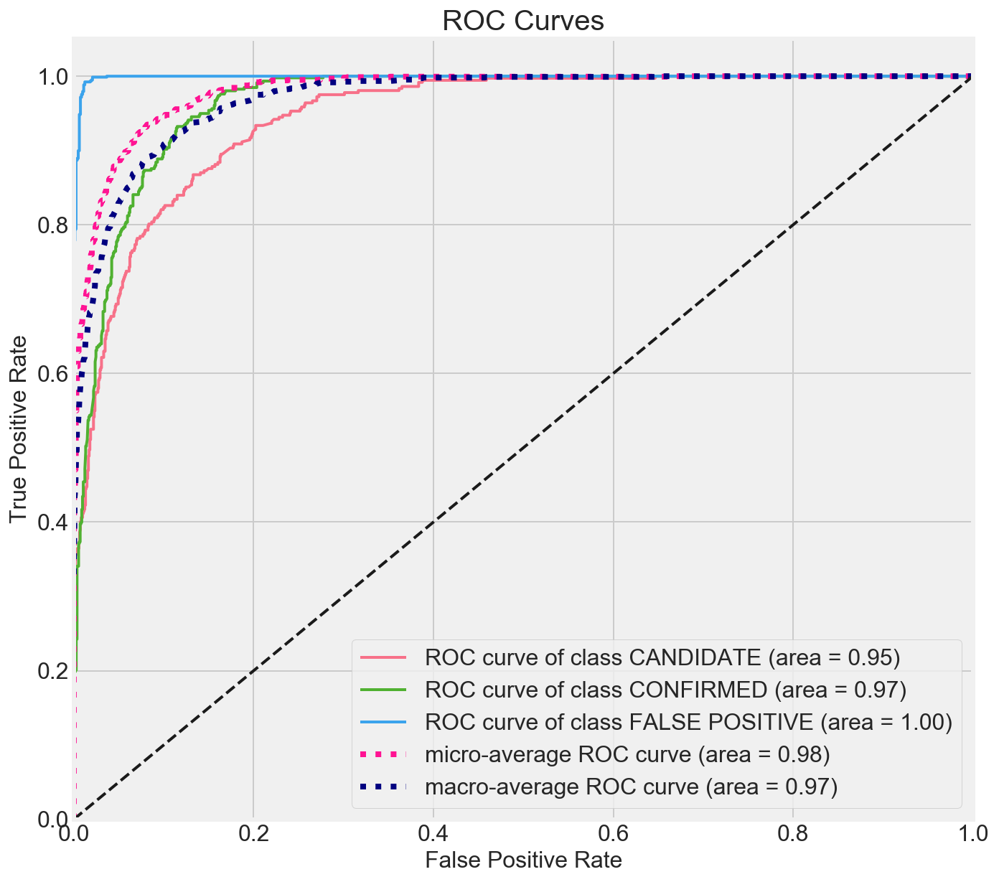

In [222]:
fig, ax = plt.subplots(figsize=(10,10))
skplt.metrics.plot_roc(y_test_nor, best_nor_rtc.predict_proba(x_test_std_nor), plot_micro=True, plot_macro=True, 
                       title_fontsize=20, text_fontsize=16, figsize=(8,6), cmap=cmap, ax=ax)
#plt.legend(loc='lower right')
plt.show()

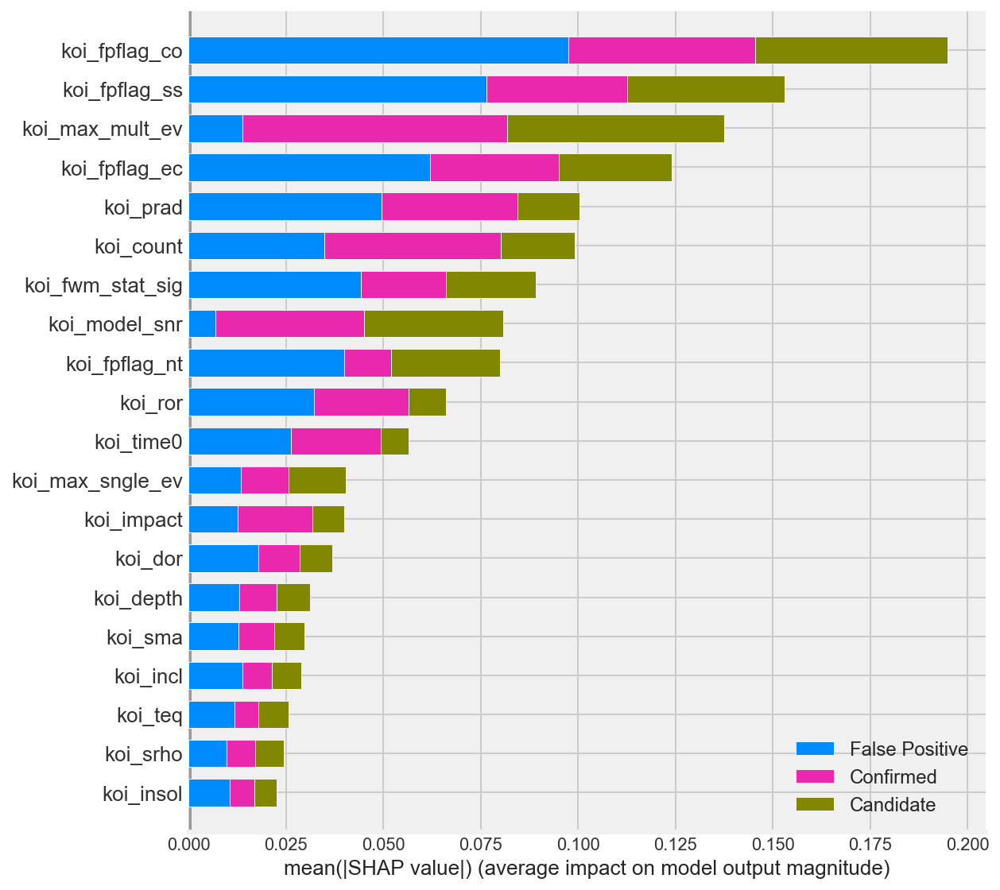

In [223]:
best_explainer = shap.TreeExplainer(best_nor_rtc)
best_shap_values = best_explainer.shap_values(x_test_std_nor)
shap.summary_plot(best_shap_values, x_test_std_nor, plot_type="bar",class_names=['Candidate','Confirmed','False Positive'])

### Neural Network 

In [233]:
## Neural Network Imports
from sklearn.base import TransformerMixin
from sklearn.preprocessing import LabelBinarizer, StandardScaler, OneHotEncoder
from sklearn.pipeline import make_pipeline, make_union
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer as Imputer
from sklearn import metrics
from sklearn.neural_network import MLPRegressor
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.base import BaseEstimator




from sklearn.neural_network import MLPClassifier






clf = MLPClassifier(solver='lbfgs',
                    alpha=10**(-10),
                    hidden_layer_sizes=(10*2, 10**2,10),
                    activation='identity',
                    random_state=1,
                    batch_size='auto')
clf.fit(x_train_nor, y_train_nor)
accuracy_score(y_test_nor, clf.predict(x_test_std_nor))
#print(metrics.accuracy_score(y_test_nor, clf.predict(x_test_std_nor)[:, 1]))



0.5193992490613266

## Write up

The goal of my model is to correctly classify Kepler Objects of Interest as False Positive, Candidate or Confirmed. What this means is that whether a light source observed by the Kepler Telescope is a star with an actual solar systems and should be investigated as to whether there is an exoplanet present.

I have a variety of metrics ranging from how many planets are present in the stars system, to whether the star’s light emittance is mimicking that of a star with planets in the system, to the phosphoric temperature of the star, and the radius of the star.

There were also a large amount of predictive variables present which I had to filter out in the early stages, variables such as the spatial co-ordinates (in a variety of formats), how long it took planets to rotate around the star, and a lot of error variables ( an upper and lower bound for how correct the value is). Initially I wasn’t going to drop the error variables but after I ran a few initial models I decided to return and drop the variables with err in the title - after dropping these columns the models score improved minutely. 

I chose to drop them because Independently they add no real value to the model or its predictive power.

I found that the data reacted better to being fit by Tree models rather than a logistic regression, this led to a variety of gridsearches and running Random Forest Classifiers too. I found that the models struggled to some extent differentiating between Candidate and Positive targets - which is understandable - a false positive was believed  to be a star with a planets in its solar system initially.

To avoid overfitting I had to ensure that there was a maximum depth.

The first model fitting yielded extremely positive results - a ROC curve showed that nearly all the [False Positives reword] had been correctly identified (it had a ROC area of 1) and looking at the confusion matrix only 4 were mistakenly classified out of 777. Both ROC curve scores for the Positive and Candidate classifications prove confidence in the Tree models.

 

Upon finding these scores I decided to use a shap graph on the model to further look into the variables and their impact on the model. I was surprised to find that the variable with the most impact was the KOI_FPFLAG_SS which provided a 0 or 1 value, a zero where the variable was an actual solar system and not due to a secondary event such a sun eclipsing or self producing light. This makes sense when thinking about it since it will eliminate a lot of the False Positives straight out. It had the biggest impact in classifications of each label.

I then went onto test for a Random Forest Classifier which improved the score slightly.

Due to the results I decided to observe the data again and think of a different way to transform it, spacial data can contain very varied data which isn’t always due to a machine error or outlier. It can be just that - an extreme value. Therefore I decided to run to normalise the data and then standard scale transform it. Run Logistic Regression, Decision Tree and ultimately Random Forest models.  I saw a notable increase when I used the Random Forest Classifier as my score reached .91. The ROC curve showed increase for the Candidate and Confirmed classes, which reveals a better False Positive and False negative classification.

Ultimately I believe that the compatibility to real life production would be extremely varied and potentially not have the greatest cross over. This is largely based on my assumption my model was extremely dependent on a single variable in classifying my classes, this dependence could be troublesome with unseen data and there could be some new reason or phenom which could cause the appearance of the stars light emittance to mimic that of a solar system. Hence that this model would be good in producing starting points for investigation and using the results to dig deeper into those Confirmed and Candidate classes.